Is this effecient? Not at all! Might come back later to make a function or loop to subplot all of this stuff. This was just basic exploration without optimization in mind.

In [172]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Minimal cleaning/renaming was done for EDA as everything is internal.

Downloaded SL and CW reports as Excel files from https://www.cps.edu/about/district-data/metrics/
-Removed the Overview tab from both files.
-Removed footnotes from SL file as it created rows full of only NA values after saving as CSV.
-Removed top header and used subheaders as headers to avoid reading issues with loading into DF.
-After the above steps were taken, saved both files as a CSV with UTF-8 encoding.
-Note:  Superscripts get saved as normal numbers, i.e., test^2 would save as test2. Might go back and clean up or maybe leave as is.
-SL data types became object; had to astype relevent columns to int before creating visualizations.

-EOY:  Data from 7/1 to 6/30 of the respective year; includes S1 data.
-2 All CPS schools should document and track all misconducts that arise to the level of an Office Disciplinary Referral and are Student Code of Conduct infractions.
    The # of Misconducts displayed here represents all Student Code of Conduct infractions that have been reported through IMPACT Verify each school year.
-3 Group 1-2 Example: Leaving class without permission
-4 Group 3-4 Example: Fighting
-5 Group 5-6 Example: Gang activity
-Schools are able to apply both an in school and out of school suspension to one misconduct event. In those cases, the suspension is only counted once.
-Misconduct and suspension data includes only district-managed schools; Expulsion data includes all district-managed and charter schools.

In [173]:
#sl = School Level
sl_2022 = pd.read_csv("misconduct_report_police_and_expulsion_thru_eoy_2022_school_level.csv")

#dl = District Level
dl_2022 = pd.read_csv("misconduct_report_police_and_expulsion_thru_eoy_2022_district_level.csv")

In [174]:
dl_2022.head()

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
0,District Wide,2013-2014,S1,61661.0,31505.0,26153.0,4003.0,45455.0,73.7,20226.0,...,0.68,1864.0,0.6,205.0,0.06,70.0,0.02,135.0,0.28,NaN
1,District Wide,2013-2014,EOY,120543.0,58906.0,53311.0,8326.0,87763.0,72.8,38055.0,...,1.46,3543.0,1.2,495.0,0.17,184.0,0.06,311.0,0.79,NaN
2,District Wide,2014-2015,S1,60026.0,35577.0,20971.0,3478.0,27601.0,46.0,17675.0,...,0.61,1671.0,0.5,138.0,0.04,20.0,0.01,118.0,0.23,NaN
3,District Wide,2014-2015,EOY,132529.0,74771.0,49841.0,7917.0,63031.0,47.6,38668.0,...,1.42,3347.0,1.1,430.0,0.15,111.0,0.04,319.0,0.78,NaN
4,District Wide,2015-2016,S1,60093.0,34187.0,22244.0,3662.0,26924.0,44.8,16747.0,...,0.48,1340.0,0.4,138.0,0.04,34.0,0.01,104.0,0.20,NaN


In [175]:
dl_2022['Category'].unique()

array(['District Wide', 'Male', 'Female', 'Non-Binary Gender',
       'Students With IEPs', 'English Language Learners', 'White',
       'African American', 'Native American / Alaskan',
       'Asian / Pacific Islander 7', 'Hispanic', 'Multiracial', 'Asian',
       'Hawaiian / Pacific Islander', 'Race Not Available', 'White Male',
       'White Female', 'White Non-Binary', 'African American Male',
       'African American Female', 'African American Non-Binary',
       'Native American / Alaskan Male',
       'Native American / Alaskan Female',
       'Asian / Pacific Islander Male 7',
       'Asian / Pacific Islander Female 7', 'Hispanic Male',
       'Hispanic Female', 'Hispanic Non-Binary', 'Multiracial Male',
       'Multiracial Female', 'Mutlracial Nonbinary', 'Asian Male',
       'Asian Female', 'Hawaiian / Pacific Islander Male',
       'Hawaiian / Pacific Islander Female', 'Race Not Available Male',
       'Race Not Available Female', 'Grade PK-2', 'Grade 3-5',
       'Grade 6-8

In [176]:
PK2 = dl_2022.loc[(dl_2022['Category'] == 'Grade PK-2') & (dl_2022['Time Period1'] == 'EOY')]

In [177]:
PK2.head(25)

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
582,Grade PK-2,2013-2014,EOY,5014.0,2353.0,2413.0,248.0,2243.0,44.7,410.0,...,0.04,33.0,0.0,1.0,0.0,NaN,NaN,1.0,0.00,NaN
584,Grade PK-2,2014-2015,EOY,6012.0,3731.0,2140.0,141.0,215.0,3.6,121.0,...,0.05,39.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
586,Grade PK-2,2015-2016,EOY,5450.0,3481.0,1819.0,150.0,25.0,0.5,3.0,...,0.05,34.0,0.0,2.0,0.0,NaN,NaN,2.0,0.01,NaN
588,Grade PK-2,2016-2017,EOY,4655.0,2887.0,1637.0,131.0,18.0,0.4,5.0,...,0.06,40.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590,Grade PK-2,2017-2018,EOY,4703.0,3135.0,1470.0,98.0,21.0,0.4,4.0,...,0.06,42.0,0.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
592,Grade PK-2,2018-2019,EOY,4648.0,3186.0,1264.0,198.0,26.0,0.6,12.0,...,0.04,24.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
594,Grade PK-2,2019-2020,EOY,1737.0,1059.0,633.0,45.0,10.0,0.6,4.0,...,0.02,15.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
596,Grade PK-2,2020-2021,EOY,288.0,197.0,80.0,11.0,1.0,0.3,NaN,...,0.00,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
598,Grade PK-2,2021-2022,EOY,2104.0,1182.0,863.0,59.0,3.0,0.1,NaN,...,0.03,14.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


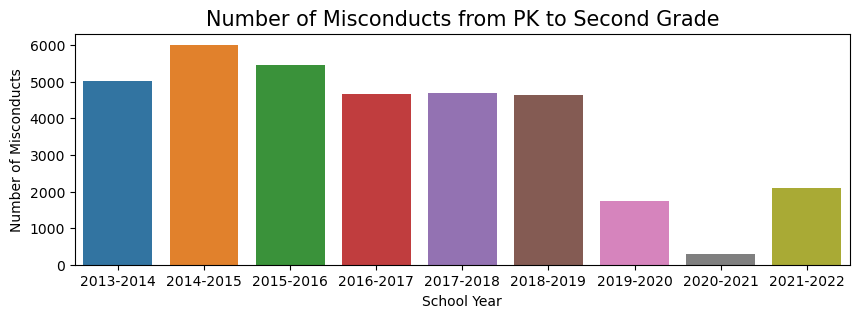

In [178]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = PK2['School Year'], y = PK2['# of Misconducts2'])

plt.title('Number of Misconducts from PK to Second Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Misconducts');

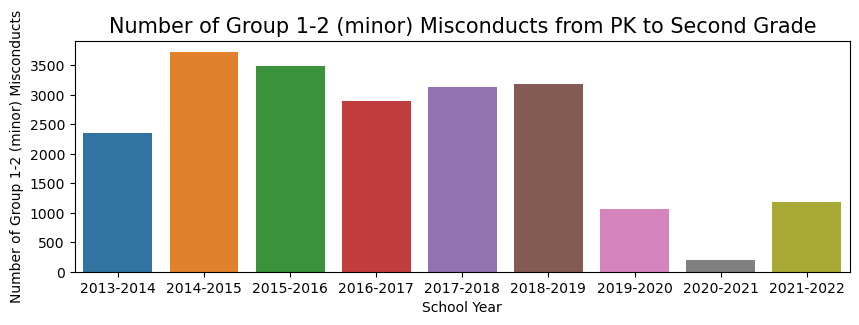

In [179]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = PK2['School Year'], y = PK2['# of Group 1-2 (minor) Misconducts3'])

plt.title('Number of Group 1-2 (minor) Misconducts from PK to Second Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 1-2 (minor) Misconducts');

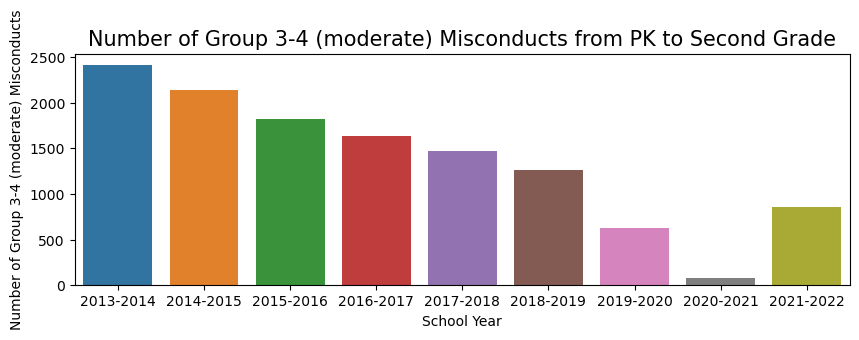

In [180]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = PK2['School Year'], y = PK2['# of Group 3-4 (moderate) Misconducts4'])

plt.title('Number of Group 3-4 (moderate) Misconducts from PK to Second Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 3-4 (moderate) Misconducts');

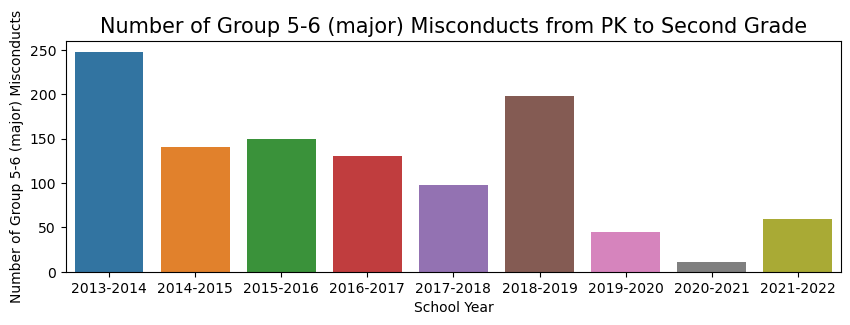

In [181]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = PK2['School Year'], y = PK2['# of Group 5-6 (major) Misconducts5'])

plt.title('Number of Group 5-6 (major) Misconducts from PK to Second Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 5-6 (major) Misconducts');

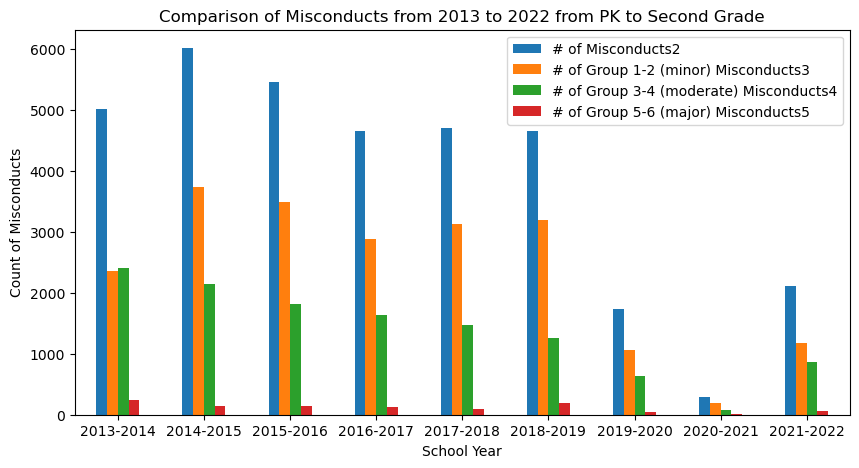

In [182]:
plt.rcParams['figure.figsize'] = (10,5)
ax = PK2.plot(x ='School Year',
    y=['# of Misconducts2','# of Group 1-2 (minor) Misconducts3','# of Group 3-4 (moderate) Misconducts4','# of Group 5-6 (major) Misconducts5'],
    kind='bar',
    rot=0,
    title='Comparison of Misconducts from 2013 to 2022 from PK to Second Grade')
#ax.set_xlabel('')
ax.set_ylabel('Count of Misconducts');


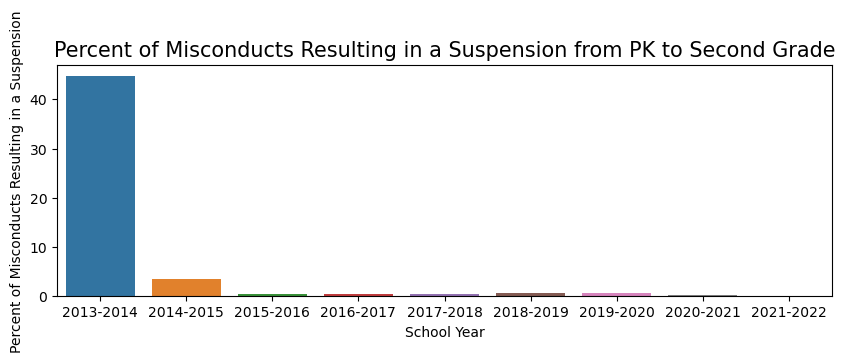

In [183]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = PK2['School Year'], y = PK2['% of Misconducts Resulting in a Suspension'])

plt.title('Percent of Misconducts Resulting in a Suspension from PK to Second Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Percent of Misconducts Resulting in a Suspension');

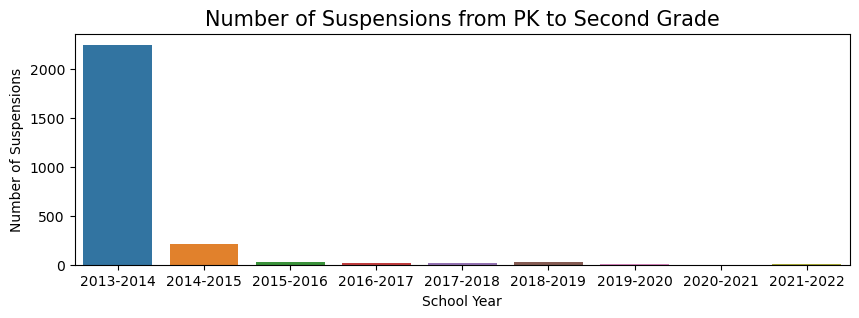

In [184]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = PK2['School Year'], y = PK2['# of Suspensions6'])

plt.title('Number of Suspensions from PK to Second Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Suspensions');

In [185]:
G35 = dl_2022.loc[(dl_2022['Category'] == 'Grade 3-5') & (dl_2022['Time Period1'] == 'EOY')]

In [186]:
G35.head(25)

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
600,Grade 3-5,2013-2014,EOY,13083.0,4892.0,7633.0,558.0,8027.0,61.4,1606.0,...,0.20,123.0,0.2,5.0,0.0,NaN,NaN,5.0,0.02,NaN
602,Grade 3-5,2014-2015,EOY,15935.0,8152.0,7253.0,530.0,5442.0,34.2,2463.0,...,0.21,133.0,0.2,8.0,0.0,4.0,0.0,4.0,0.02,NaN
604,Grade 3-5,2015-2016,EOY,16243.0,7888.0,7874.0,481.0,5720.0,35.2,2596.0,...,0.25,144.0,0.2,2.0,0.0,NaN,NaN,2.0,0.01,NaN
606,Grade 3-5,2016-2017,EOY,13740.0,7067.0,6206.0,467.0,4795.0,34.9,2176.0,...,0.26,165.0,0.2,1.0,0.0,NaN,NaN,1.0,0.00,NaN
608,Grade 3-5,2017-2018,EOY,13352.0,7367.0,5526.0,459.0,4147.0,31.1,2048.0,...,0.23,128.0,0.2,2.0,0.0,NaN,NaN,2.0,0.01,NaN
610,Grade 3-5,2018-2019,EOY,11349.0,6089.0,4753.0,507.0,3224.0,28.4,1750.0,...,0.14,86.0,0.1,3.0,0.0,NaN,NaN,3.0,0.01,NaN
612,Grade 3-5,2019-2020,EOY,5406.0,2387.0,2714.0,305.0,1363.0,25.2,760.0,...,0.18,87.0,0.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
614,Grade 3-5,2020-2021,EOY,931.0,637.0,267.0,27.0,3.0,0.3,NaN,...,0.01,5.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
616,Grade 3-5,2021-2022,EOY,6701.0,2969.0,3377.0,355.0,1399.0,20.9,621.0,...,0.17,66.0,0.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN


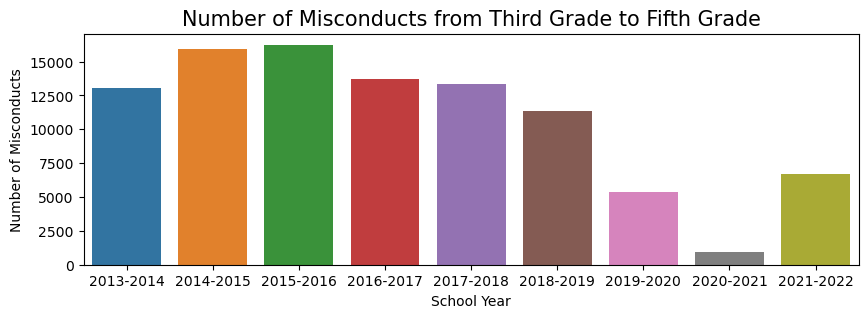

In [187]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G35['School Year'], y = G35['# of Misconducts2'])

plt.title('Number of Misconducts from Third Grade to Fifth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Misconducts');

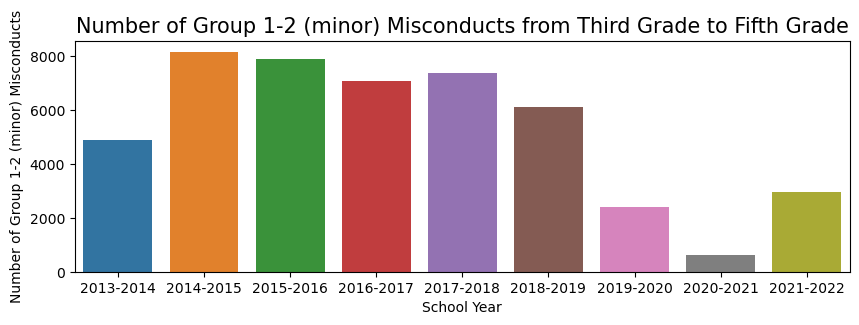

In [188]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G35['School Year'], y = G35['# of Group 1-2 (minor) Misconducts3'])

plt.title('Number of Group 1-2 (minor) Misconducts from Third Grade to Fifth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 1-2 (minor) Misconducts');

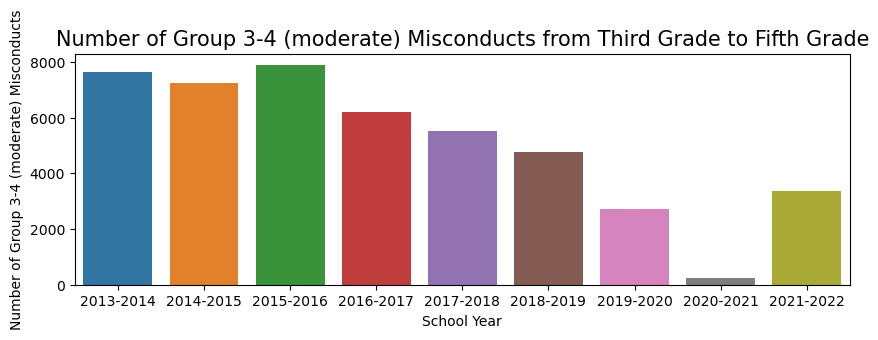

In [189]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G35['School Year'], y = G35['# of Group 3-4 (moderate) Misconducts4'])

plt.title('Number of Group 3-4 (moderate) Misconducts from Third Grade to Fifth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 3-4 (moderate) Misconducts');

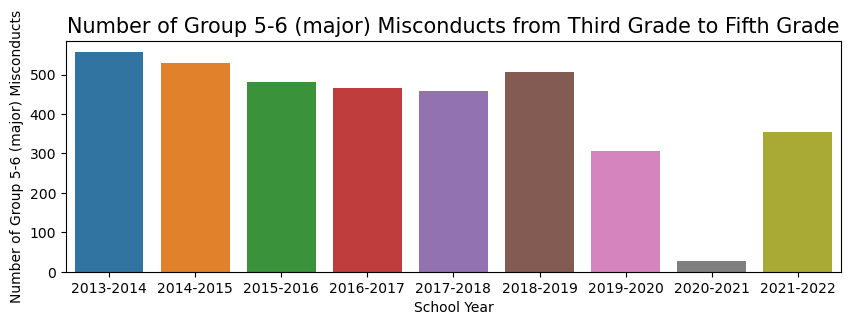

In [190]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G35['School Year'], y = G35['# of Group 5-6 (major) Misconducts5'])

plt.title('Number of Group 5-6 (major) Misconducts from Third Grade to Fifth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 5-6 (major) Misconducts');

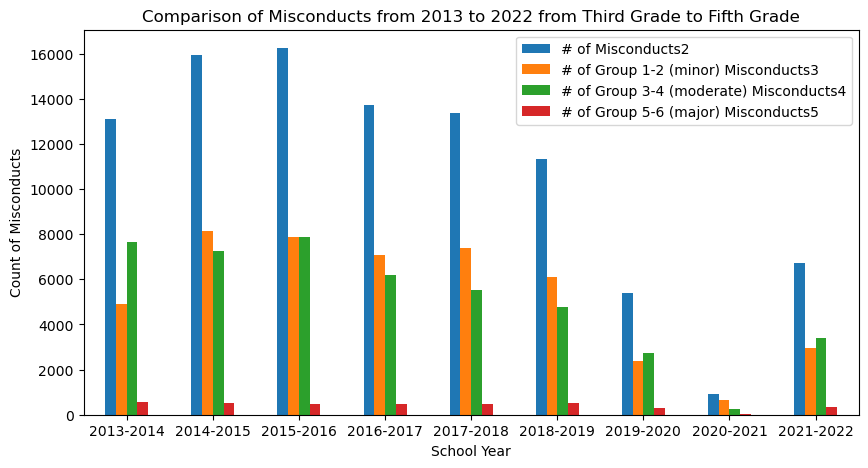

In [191]:
plt.rcParams['figure.figsize'] = (10,5)
ax = G35.plot(x ='School Year',
    y=['# of Misconducts2','# of Group 1-2 (minor) Misconducts3','# of Group 3-4 (moderate) Misconducts4','# of Group 5-6 (major) Misconducts5'],
    kind='bar',
    rot=0,
    title='Comparison of Misconducts from 2013 to 2022 from Third Grade to Fifth Grade')
#ax.set_xlabel('')
ax.set_ylabel('Count of Misconducts');

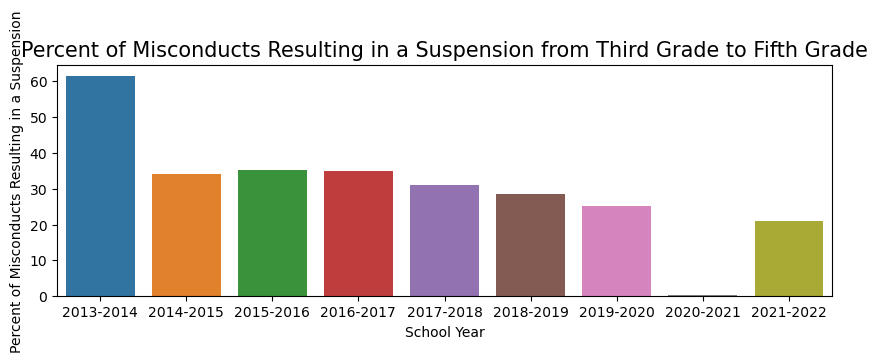

In [192]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G35['School Year'], y = G35['% of Misconducts Resulting in a Suspension'])

plt.title('Percent of Misconducts Resulting in a Suspension from Third Grade to Fifth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Percent of Misconducts Resulting in a Suspension');


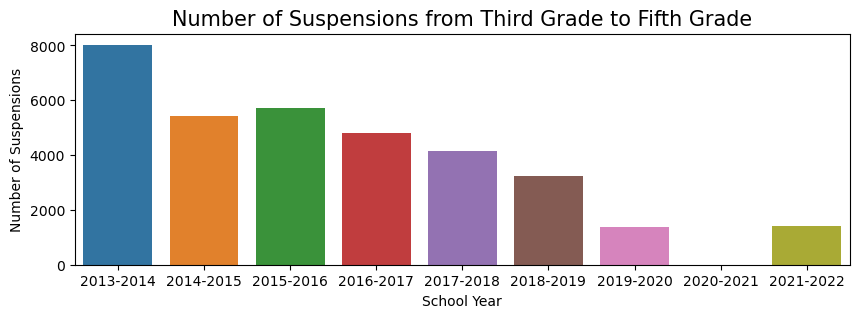

In [193]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G35['School Year'], y = G35['# of Suspensions6'])

plt.title('Number of Suspensions from Third Grade to Fifth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Suspensions');

In [194]:
G68 = dl_2022.loc[(dl_2022['Category'] == 'Grade 6-8') & (dl_2022['Time Period1'] == 'EOY')]

In [195]:
G68.head(25)

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
618,Grade 6-8,2013-2014,EOY,25247.0,9095.0,13696.0,2456.0,16774.0,66.4,3389.0,...,1.50,840.0,1.3,110.0,0.06,79.0,0.04,31.0,0.14,NaN
620,Grade 6-8,2014-2015,EOY,26640.0,13111.0,11639.0,1890.0,10467.0,39.3,4588.0,...,1.36,744.0,1.1,70.0,0.04,34.0,0.02,36.0,0.15,NaN
622,Grade 6-8,2015-2016,EOY,26029.0,12930.0,11275.0,1824.0,11222.0,43.1,5053.0,...,1.33,693.0,1.1,58.0,0.03,29.0,0.02,29.0,0.12,NaN
624,Grade 6-8,2016-2017,EOY,23923.0,12280.0,9964.0,1679.0,9901.0,41.4,4556.0,...,1.13,564.0,0.9,35.0,0.02,25.0,0.01,10.0,0.04,NaN
626,Grade 6-8,2017-2018,EOY,20817.0,10258.0,8780.0,1779.0,8554.0,41.1,4270.0,...,1.10,596.0,0.9,40.0,0.02,24.0,0.01,16.0,0.07,NaN
628,Grade 6-8,2018-2019,EOY,20131.0,9757.0,8144.0,2230.0,8241.0,40.9,4697.0,...,0.90,486.0,0.8,27.0,0.01,17.0,0.01,10.0,0.04,NaN
630,Grade 6-8,2019-2020,EOY,10141.0,3934.0,5209.0,998.0,3907.0,38.5,2155.0,...,1.09,537.0,0.9,9.0,0.01,4.0,0.00,5.0,0.02,NaN
632,Grade 6-8,2020-2021,EOY,1437.0,786.0,582.0,69.0,22.0,1.5,1.0,...,0.06,30.0,0.1,2.0,0.00,NaN,NaN,2.0,0.01,NaN
634,Grade 6-8,2021-2022,EOY,15071.0,6102.0,7656.0,1313.0,4426.0,29.4,2110.0,...,0.93,365.0,0.8,5.0,0.00,3.0,0.00,2.0,0.01,NaN


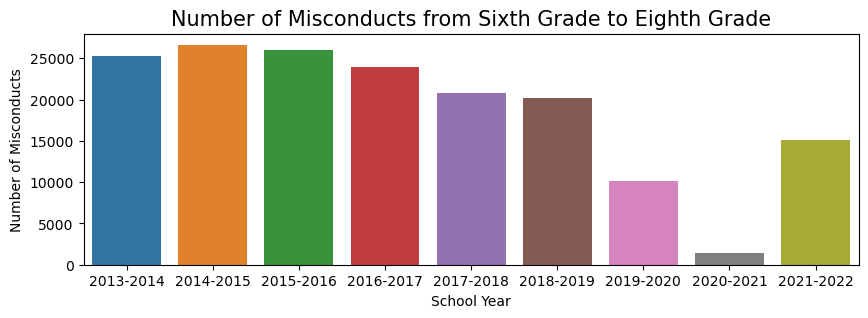

In [196]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G68['School Year'], y = G68['# of Misconducts2'])

plt.title('Number of Misconducts from Sixth Grade to Eighth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Misconducts');

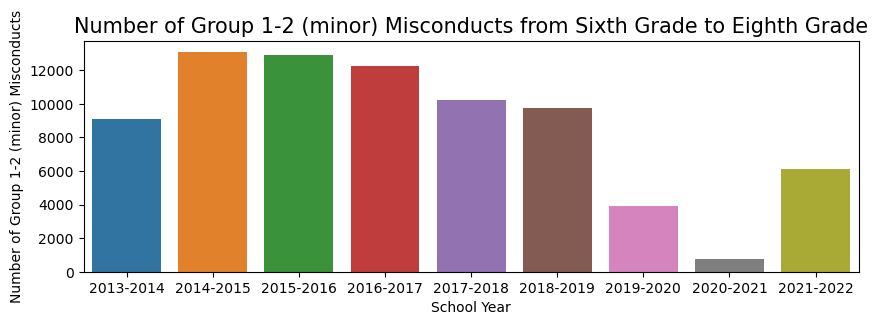

In [197]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G68['School Year'], y = G68['# of Group 1-2 (minor) Misconducts3'])

plt.title('Number of Group 1-2 (minor) Misconducts from Sixth Grade to Eighth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 1-2 (minor) Misconducts');

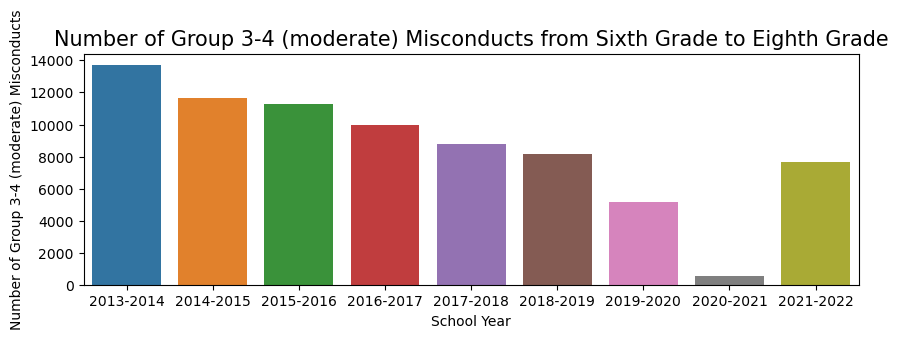

In [198]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G68['School Year'], y = G68['# of Group 3-4 (moderate) Misconducts4'])

plt.title('Number of Group 3-4 (moderate) Misconducts from Sixth Grade to Eighth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 3-4 (moderate) Misconducts');

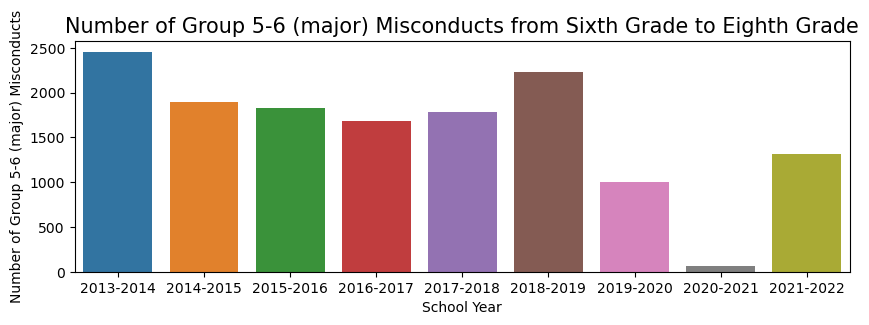

In [199]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G68['School Year'], y = G68['# of Group 5-6 (major) Misconducts5'])

plt.title('Number of Group 5-6 (major) Misconducts from Sixth Grade to Eighth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 5-6 (major) Misconducts');

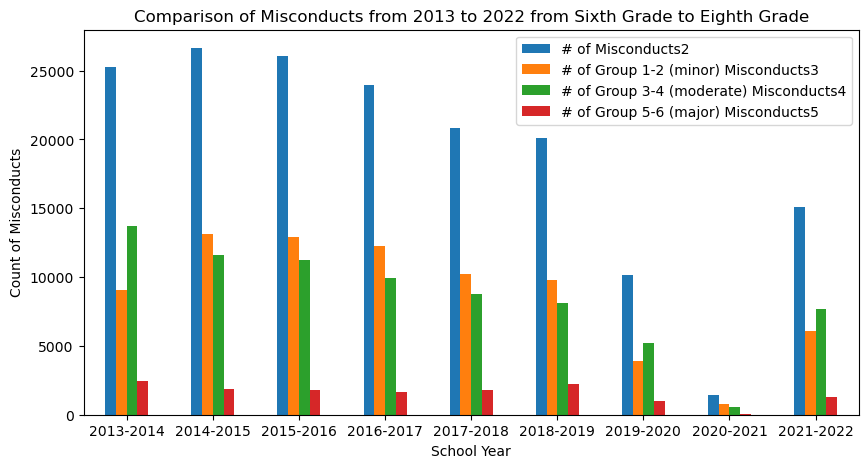

In [200]:
plt.rcParams['figure.figsize'] = (10,5)
ax = G68.plot(x ='School Year',
    y=['# of Misconducts2','# of Group 1-2 (minor) Misconducts3','# of Group 3-4 (moderate) Misconducts4','# of Group 5-6 (major) Misconducts5'],
    kind='bar',
    rot=0,
    title='Comparison of Misconducts from 2013 to 2022 from Sixth Grade to Eighth Grade')
#ax.set_xlabel('')
ax.set_ylabel('Count of Misconducts');

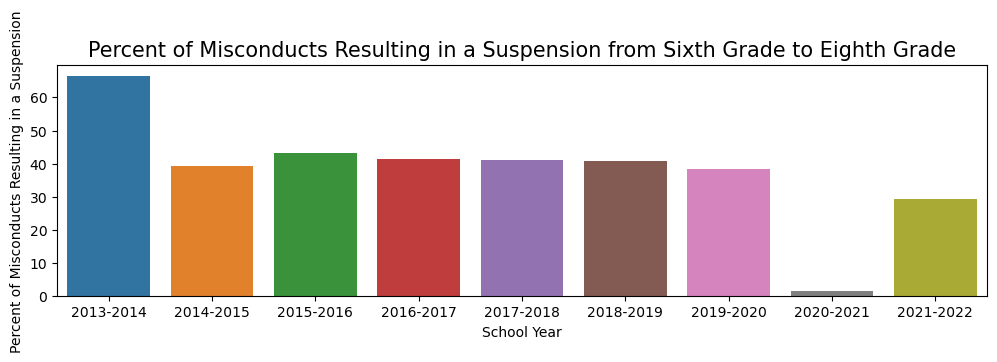

In [201]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(12,3))
sns.barplot(x = G68['School Year'], y = G68['% of Misconducts Resulting in a Suspension'])

plt.title('Percent of Misconducts Resulting in a Suspension from Sixth Grade to Eighth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Percent of Misconducts Resulting in a Suspension');


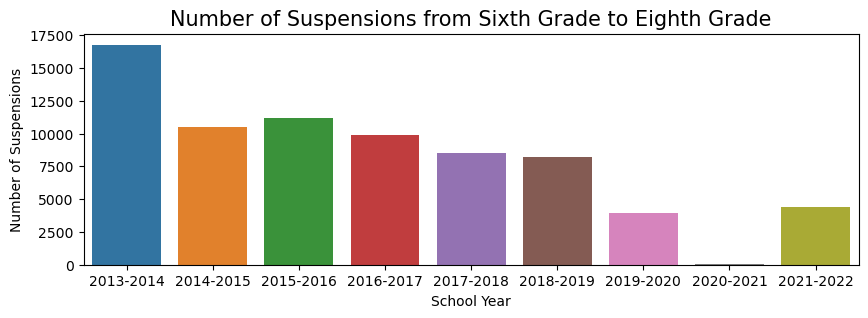

In [202]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G68['School Year'], y = G68['# of Suspensions6'])

plt.title('Number of Suspensions from Sixth Grade to Eighth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Suspensions');

In [203]:
G912 = dl_2022.loc[(dl_2022['Category'] == 'Grade 9-12') & (dl_2022['Time Period1'] == 'EOY')]

In [204]:
G912.head(25)

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
636,Grade 9-12,2013-2014,EOY,77182.0,42561.0,29564.0,5057.0,60702.0,78.6,32645.0,...,4.26,2543.0,3.4,377.0,0.11,103.0,0.03,274.0,0.35,NaN
638,Grade 9-12,2014-2015,EOY,83937.0,49777.0,28806.0,5354.0,46906.0,55.9,31496.0,...,4.19,2430.0,3.3,352.0,0.11,73.0,0.02,279.0,0.38,NaN
640,Grade 9-12,2015-2016,EOY,74374.0,44073.0,25032.0,5269.0,40348.0,54.3,26517.0,...,3.13,1765.0,2.5,296.0,0.09,46.0,0.02,250.0,0.29,NaN
642,Grade 9-12,2016-2017,EOY,58121.0,39807.0,14560.0,3754.0,23475.0,40.4,14834.0,...,2.49,1443.0,2.1,222.0,0.06,78.0,0.03,144.0,0.16,NaN
644,Grade 9-12,2017-2018,EOY,58848.0,42689.0,12413.0,3746.0,21442.0,36.4,14282.0,...,2.47,1229.0,2.1,156.0,0.05,28.0,0.01,128.0,0.16,NaN
646,Grade 9-12,2018-2019,EOY,40707.0,23611.0,12219.0,4877.0,21204.0,52.1,14671.0,...,1.77,883.0,1.5,133.0,0.04,8.0,0.00,123.0,0.14,NaN
648,Grade 9-12,2019-2020,EOY,31117.0,19187.0,10246.0,1684.0,9766.0,31.4,6105.0,...,1.53,754.0,1.4,63.0,0.02,12.0,0.01,51.0,0.07,NaN
650,Grade 9-12,2020-2021,EOY,1266.0,730.0,477.0,59.0,18.0,1.4,NaN,...,0.03,17.0,0.0,2.0,0.00,NaN,NaN,2.0,0.00,NaN
652,Grade 9-12,2021-2022,EOY,48472.0,33134.0,12189.0,3149.0,10279.0,21.2,3387.0,...,1.45,686.0,1.3,108.0,0.04,30.0,0.01,78.0,0.09,NaN


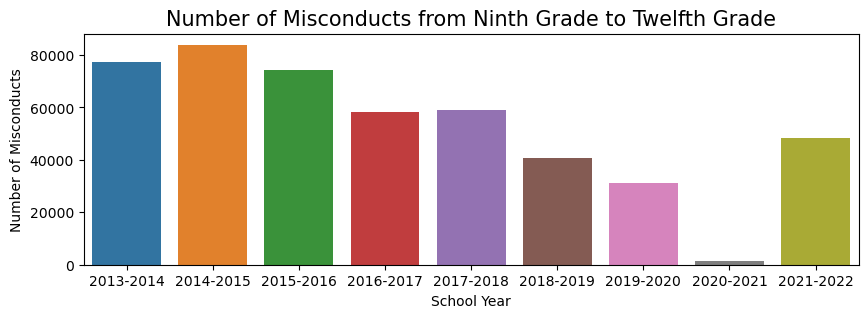

In [205]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G912['School Year'], y = G912['# of Misconducts2'])

plt.title('Number of Misconducts from Ninth Grade to Twelfth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Misconducts');

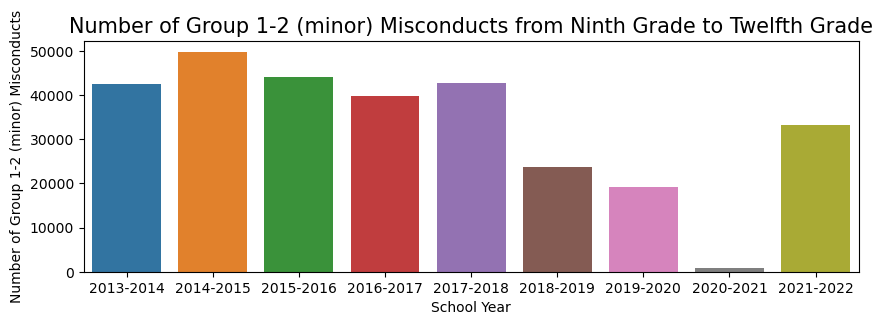

In [206]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G912['School Year'], y = G912['# of Group 1-2 (minor) Misconducts3'])

plt.title('Number of Group 1-2 (minor) Misconducts from Ninth Grade to Twelfth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 1-2 (minor) Misconducts');

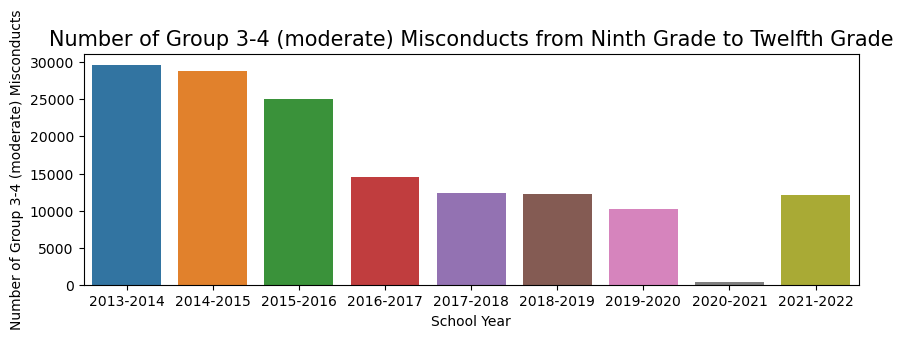

In [207]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G912['School Year'], y = G912['# of Group 3-4 (moderate) Misconducts4'])

plt.title('Number of Group 3-4 (moderate) Misconducts from Ninth Grade to Twelfth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 3-4 (moderate) Misconducts');

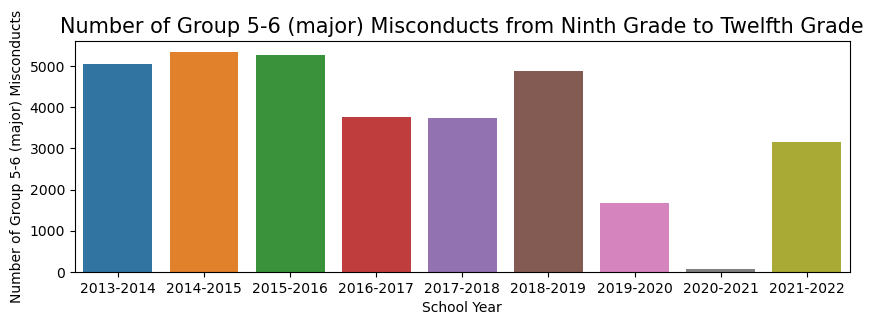

In [208]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G912['School Year'], y = G912['# of Group 5-6 (major) Misconducts5'])

plt.title('Number of Group 5-6 (major) Misconducts from Ninth Grade to Twelfth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Group 5-6 (major) Misconducts');

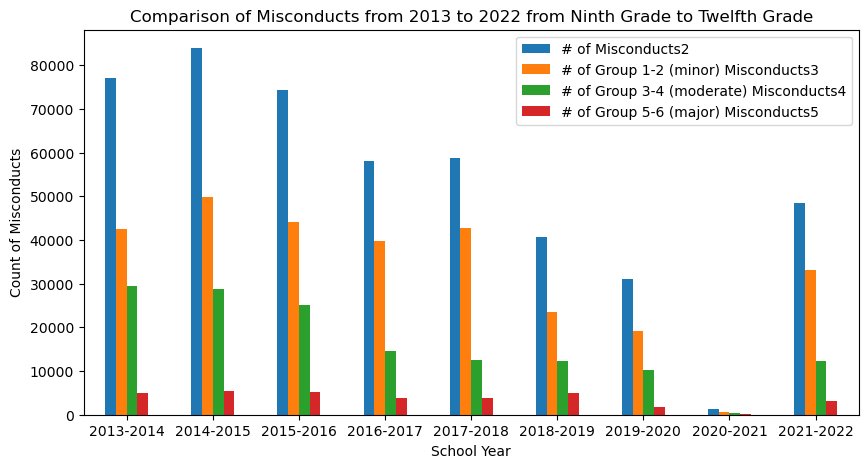

In [209]:
plt.rcParams['figure.figsize'] = (10,5)
ax = G912.plot(x ='School Year',
    y=['# of Misconducts2','# of Group 1-2 (minor) Misconducts3','# of Group 3-4 (moderate) Misconducts4','# of Group 5-6 (major) Misconducts5'],
    kind='bar',
    rot=0,
    title='Comparison of Misconducts from 2013 to 2022 from Ninth Grade to Twelfth Grade')
#ax.set_xlabel('')
ax.set_ylabel('Count of Misconducts');

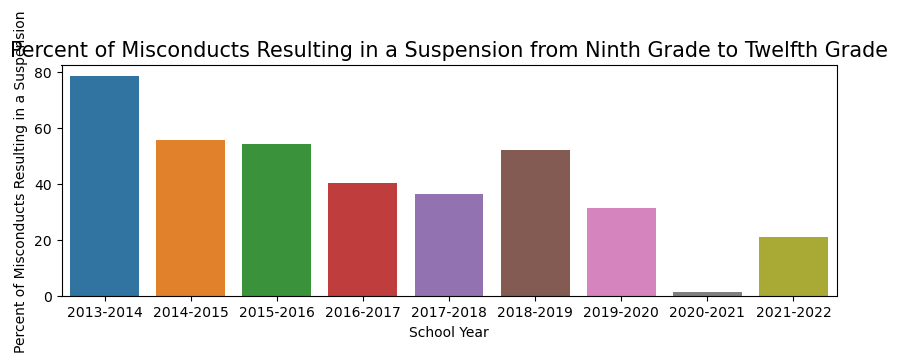

In [210]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G912['School Year'], y = G912['% of Misconducts Resulting in a Suspension'])

plt.title('Percent of Misconducts Resulting in a Suspension from Ninth Grade to Twelfth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Percent of Misconducts Resulting in a Suspension');


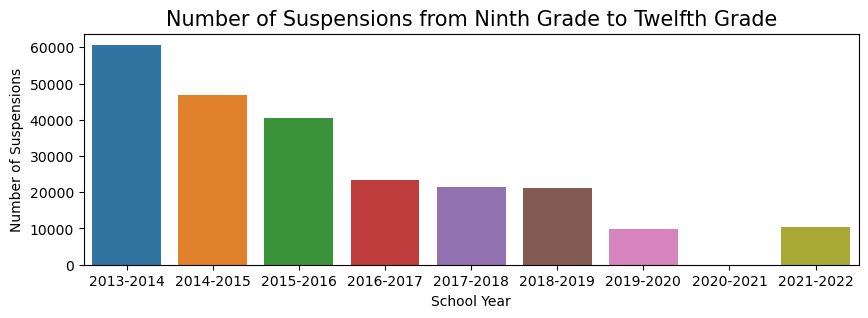

In [211]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = G912['School Year'], y = G912['# of Suspensions6'])

plt.title('Number of Suspensions from Ninth Grade to Twelfth Grade', size = 15);
plt.xlabel('School Year');
plt.ylabel('Number of Suspensions');

In [212]:
# PK12 = dl_2022.loc[((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12')) & (dl_2022['Time Period1'] == 'EOY')]
# PK12['Category'].unique()
# PK12.head()

In [213]:
dl_2022['School Year'].unique()

array(['2013-2014', '2014-2015', '2015-2016', '2016-2017', '2017-2018',
       '2018-2019', '2019-2020', '2020-2021', '2021-2022', nan],
      dtype=object)

In [214]:
SY1314 = dl_2022.loc[(dl_2022['School Year'] == '2013-2014') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY1415 = dl_2022.loc[(dl_2022['School Year'] == '2014-2015') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY1516 = dl_2022.loc[(dl_2022['School Year'] == '2015-2016') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY1617 = dl_2022.loc[(dl_2022['School Year'] == '2016-2017') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY1718 = dl_2022.loc[(dl_2022['School Year'] == '2017-2018') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY1819 = dl_2022.loc[(dl_2022['School Year'] == '2018-2019') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY1920 = dl_2022.loc[(dl_2022['School Year'] == '2019-2020') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY2021 = dl_2022.loc[(dl_2022['School Year'] == '2020-2021') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]
SY2122 = dl_2022.loc[(dl_2022['School Year'] == '2021-2022') & (dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5') | (dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]

In [215]:
SY1314.head()

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
582,Grade PK-2,2013-2014,EOY,5014.0,2353.0,2413.0,248.0,2243.0,44.7,410.0,...,0.04,33.0,0.0,1.0,0.00,NaN,NaN,1.0,0.00,NaN
600,Grade 3-5,2013-2014,EOY,13083.0,4892.0,7633.0,558.0,8027.0,61.4,1606.0,...,0.20,123.0,0.2,5.0,0.00,NaN,NaN,5.0,0.02,NaN
618,Grade 6-8,2013-2014,EOY,25247.0,9095.0,13696.0,2456.0,16774.0,66.4,3389.0,...,1.50,840.0,1.3,110.0,0.06,79.0,0.04,31.0,0.14,NaN
636,Grade 9-12,2013-2014,EOY,77182.0,42561.0,29564.0,5057.0,60702.0,78.6,32645.0,...,4.26,2543.0,3.4,377.0,0.11,103.0,0.03,274.0,0.35,NaN


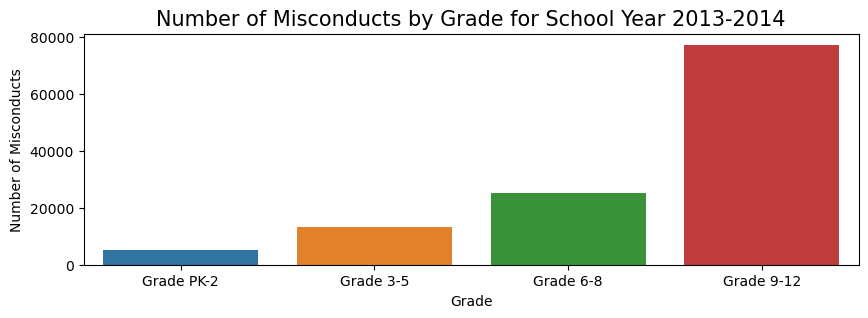

In [216]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1314['Category'], y = SY1314['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2013-2014', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

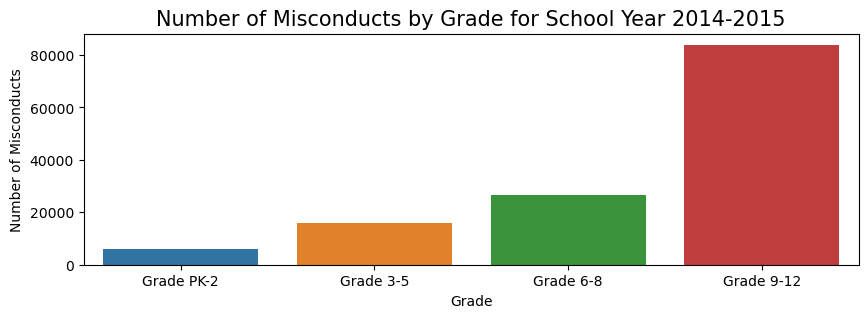

In [217]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1415['Category'], y = SY1415['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2014-2015', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

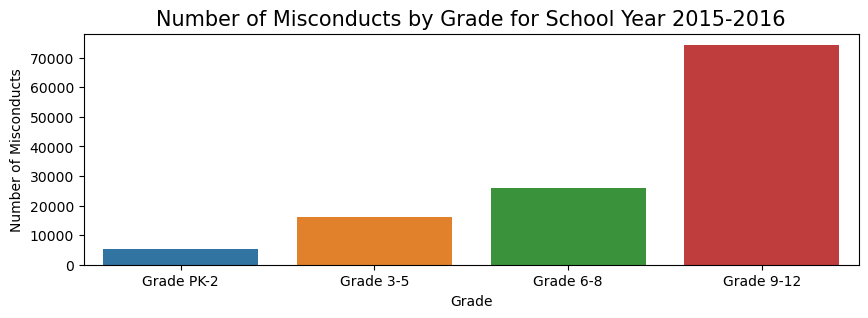

In [218]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1516['Category'], y = SY1516['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2015-2016', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

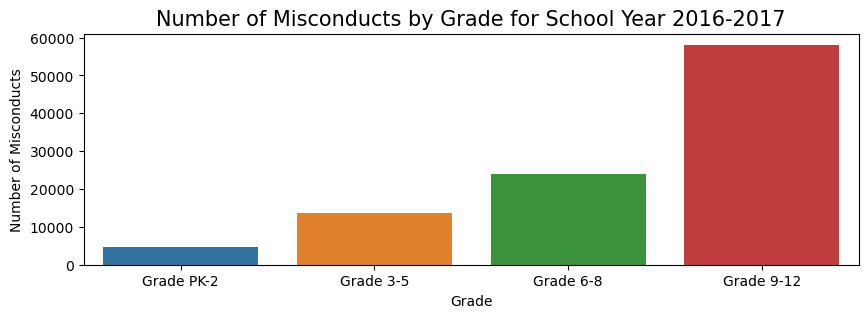

In [219]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1617['Category'], y = SY1617['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2016-2017', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

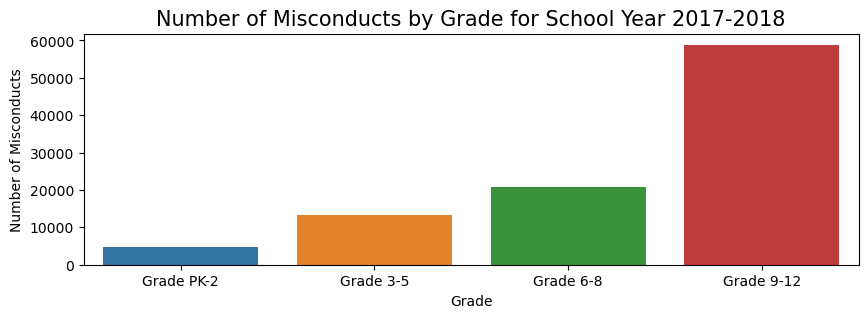

In [220]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1718['Category'], y = SY1718['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2017-2018', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

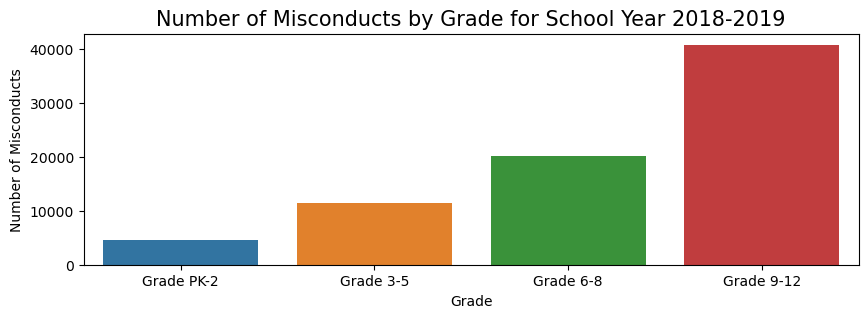

In [221]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1819['Category'], y = SY1819['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2018-2019', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

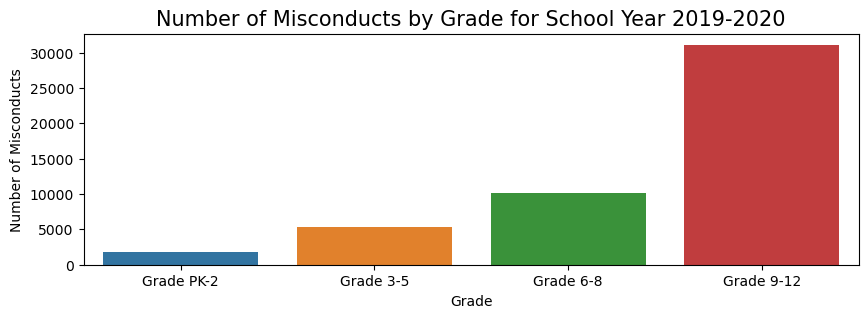

In [222]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY1920['Category'], y = SY1920['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2019-2020', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

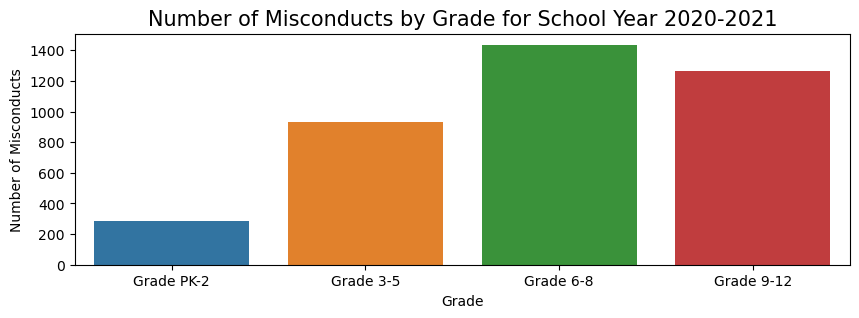

In [223]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY2021['Category'], y = SY2021['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2020-2021', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

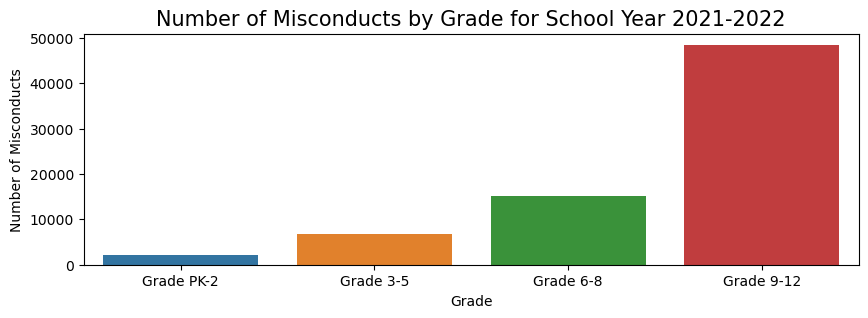

In [224]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.barplot(x = SY2122['Category'], y = SY2122['# of Misconducts2'])

plt.title('Number of Misconducts by Grade for School Year 2021-2022', size = 15);
plt.xlabel('Grade');
plt.ylabel('Number of Misconducts');

In [225]:
SY1322PK5 = dl_2022.loc[(dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade PK-2') | (dl_2022['Category'] == 'Grade 3-5'))]
SY1322612 = dl_2022.loc[(dl_2022['Time Period1'] == 'EOY') & ((dl_2022['Category'] == 'Grade 6-8') | (dl_2022['Category'] == 'Grade 9-12'))]

In [226]:
SY1322PK5.head()

,Category,School Year,Time Period1,# of Misconducts2,# of Group 1-2 (minor) Misconducts3,# of Group 3-4 (moderate) Misconducts4,# of Group 5-6 (major) Misconducts5,# of Suspensions6,% of Misconducts Resulting in a Suspension,# of ISS,...,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students,# of Students Expelled.1,Expulsions per 100 Students.1,# of Students Expelled.2,Expulsions per 100 Students.2,Unnamed: 32
582,Grade PK-2,2013-2014,EOY,5014.0,2353.0,2413.0,248.0,2243.0,44.7,410.0,...,0.04,33.0,0.0,1.0,0.0,NaN,NaN,1.0,0.00,NaN
584,Grade PK-2,2014-2015,EOY,6012.0,3731.0,2140.0,141.0,215.0,3.6,121.0,...,0.05,39.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
586,Grade PK-2,2015-2016,EOY,5450.0,3481.0,1819.0,150.0,25.0,0.5,3.0,...,0.05,34.0,0.0,2.0,0.0,NaN,NaN,2.0,0.01,NaN
588,Grade PK-2,2016-2017,EOY,4655.0,2887.0,1637.0,131.0,18.0,0.4,5.0,...,0.06,40.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590,Grade PK-2,2017-2018,EOY,4703.0,3135.0,1470.0,98.0,21.0,0.4,4.0,...,0.06,42.0,0.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN


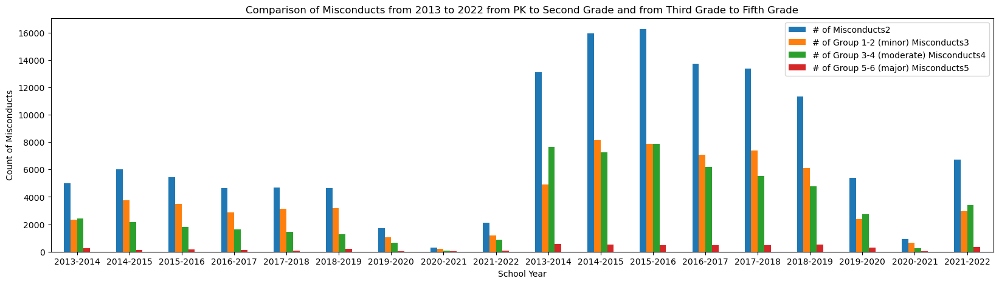

In [227]:
plt.rcParams['figure.figsize'] = (20,5)
ax = SY1322PK5.plot(x ='School Year',
    y=['# of Misconducts2','# of Group 1-2 (minor) Misconducts3','# of Group 3-4 (moderate) Misconducts4','# of Group 5-6 (major) Misconducts5'],
    kind='bar',
    rot=0,
    title='Comparison of Misconducts from 2013 to 2022 from PK to Second Grade and from Third Grade to Fifth Grade')
#ax.set_xlabel('')
ax.set_ylabel('Count of Misconducts');

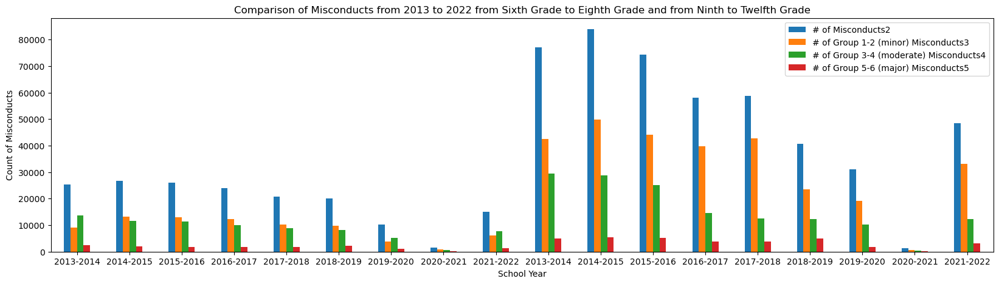

In [228]:
plt.rcParams['figure.figsize'] = (20,5)
ax = SY1322612.plot(x ='School Year',
    y=['# of Misconducts2','# of Group 1-2 (minor) Misconducts3','# of Group 3-4 (moderate) Misconducts4','# of Group 5-6 (major) Misconducts5'],
    kind='bar',
    rot=0,
    title='Comparison of Misconducts from 2013 to 2022 from Sixth Grade to Eighth Grade and from Ninth to Twelfth Grade')
#ax.set_xlabel('')
ax.set_ylabel('Count of Misconducts');

In [229]:
sl_2022.head()

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students
0,400121,ACERO - DE LA CRUZ,Charter,2017-2018,EOY,--,--,--,--,--,...,--,--,--,--,--,--,--,--,1,0.15
1,400081,ACERO - DE LAS CASAS,Charter,2018-2019,S1,--,--,--,--,--,...,--,--,--,--,--,--,--,--,1,0.38
2,400081,ACERO - DE LAS CASAS,Charter,2018-2019,EOY,--,--,--,--,--,...,--,--,--,--,--,--,--,--,1,0.38
3,400085,ACERO - GARCIA HS,Charter,2017-2018,EOY,--,--,--,--,--,...,--,--,--,--,--,--,--,--,2,0.33
4,400089,ACERO - MARQUEZ,Charter,2017-2018,S1,--,--,--,--,--,...,--,--,--,--,--,--,--,--,1,0.18


In [230]:
SL1314 = sl_2022.loc[(sl_2022['School Year'] == '2013-2014') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]

In [231]:
SL1314.head()

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,Police Notifications per 100 Students,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification,# of Students Expelled,Expulsions per 100 Students
8,609772,ADDAMS,Network 13,2013-2014,EOY,12,1,9,2,10,...,4,0.5,1,0,0,0,0,0,0,0.0
24,609773,AGASSIZ,Network 4,2013-2014,EOY,63,19,43,1,42,...,13,2.7,1.47,1,1.6,0.21,1,0.2,0,0.0
38,610513,AIR FORCE HS,Military,2013-2014,EOY,228,98,103,27,154,...,83,23.4,2.39,9,3.9,2.53,9,2.5,0,0.0
54,610212,ALBANY PARK,Network 1,2013-2014,EOY,38,22,11,5,10,...,7,2.5,2.22,6,15.8,2.13,4,1.4,0,0.0
71,609774,ALCOTT ES,Network 4,2013-2014,EOY,36,31,4,1,8,...,2,0.4,6,1,2.8,0.19,1,0.2,0,0.0


In [232]:
SL1314['School Name'].nunique()

523

In [233]:
import numpy as np
print(np.dtype(SL1314['# of Misconducts']))

object


In [234]:
SL1314 = SL1314.astype({'School Name': str, '# of Misconducts': int})
print(np.dtype(SL1314['School Name']))
print(np.dtype(SL1314['# of Misconducts']))

object
int32


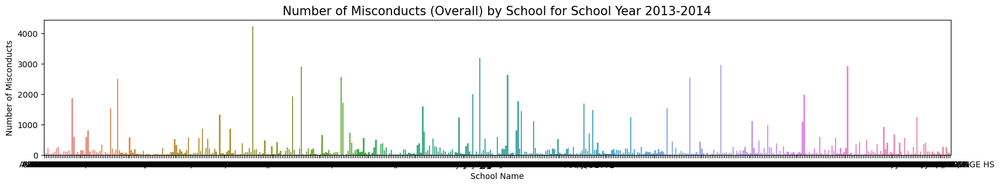

In [235]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1314['School Name'], y = SL1314['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.ylabel('Number of Misconducts');

In [236]:
SL1314v1to100 = SL1314.loc[(SL1314['# of Misconducts'] <= 100)]
SL1314v101to500 = SL1314.loc[(SL1314['# of Misconducts'] <= 500) & (SL1314['# of Misconducts'] > 100)]
SL1314v501to1000 = SL1314.loc[(SL1314['# of Misconducts'] <= 1000) & (SL1314['# of Misconducts'] > 500)]
SL1314v1001to5000 = SL1314.loc[(SL1314['# of Misconducts'] > 1000)]

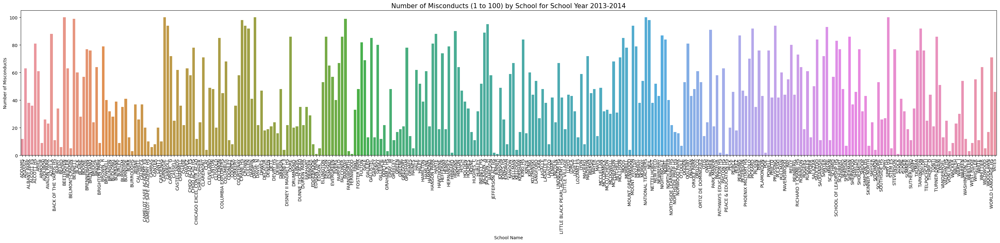

In [237]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1314v1to100['School Name'], y = SL1314v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

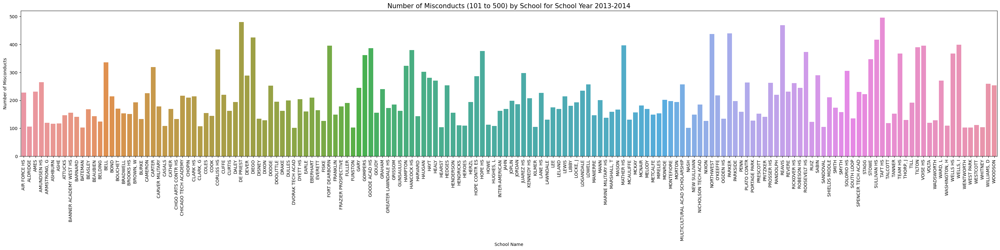

In [238]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1314v101to500['School Name'], y = SL1314v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

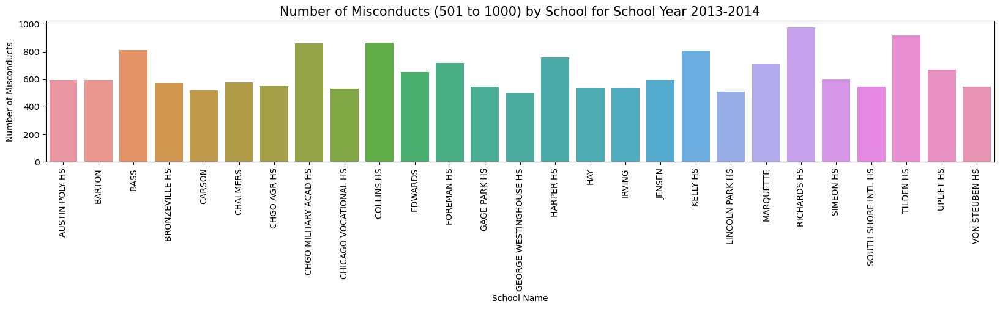

In [239]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1314v501to1000['School Name'], y = SL1314v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

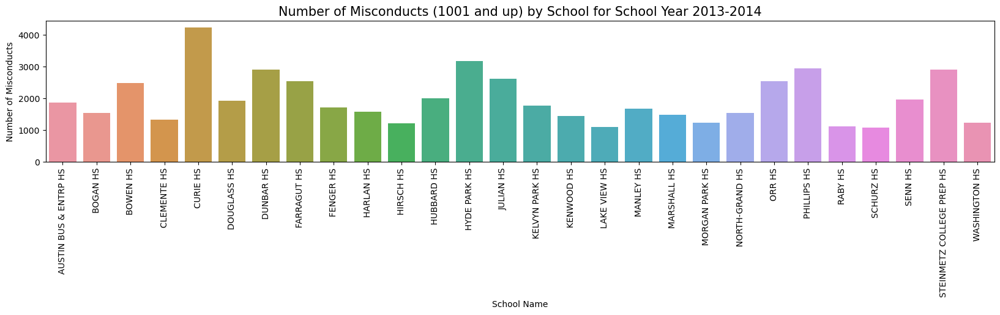

In [240]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1314v1001to5000['School Name'], y = SL1314v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

In [241]:
SL1314 = sl_2022.loc[(sl_2022['School Year'] == '2013-2014') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL1415 = sl_2022.loc[(sl_2022['School Year'] == '2014-2015') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL1516 = sl_2022.loc[(sl_2022['School Year'] == '2015-2016') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL1617 = sl_2022.loc[(sl_2022['School Year'] == '2016-2017') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL1718 = sl_2022.loc[(sl_2022['School Year'] == '2017-2018') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL1819 = sl_2022.loc[(sl_2022['School Year'] == '2018-2019') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL1920 = sl_2022.loc[(sl_2022['School Year'] == '2019-2020') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL2021 = sl_2022.loc[(sl_2022['School Year'] == '2020-2021') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]
SL2122 = sl_2022.loc[(sl_2022['School Year'] == '2021-2022') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Misconducts'] != '--')]

In [242]:
SL1314 = SL1314.astype({'School Name': str, '# of Misconducts': int})
SL1415 = SL1415.astype({'School Name': str, '# of Misconducts': int})
SL1516 = SL1516.astype({'School Name': str, '# of Misconducts': int})
SL1617 = SL1617.astype({'School Name': str, '# of Misconducts': int})
SL1718 = SL1718.astype({'School Name': str, '# of Misconducts': int})
SL1819 = SL1819.astype({'School Name': str, '# of Misconducts': int})
SL1920 = SL1920.astype({'School Name': str, '# of Misconducts': int})
SL2021 = SL2021.astype({'School Name': str, '# of Misconducts': int})
SL2122 = SL2122.astype({'School Name': str, '# of Misconducts': int})

In [243]:
SL1415v1to100 = SL1415.loc[(SL1415['# of Misconducts'] <= 100)]
SL1415v101to500 = SL1415.loc[(SL1415['# of Misconducts'] <= 500) & (SL1415['# of Misconducts'] > 100)]
SL1415v501to1000 = SL1415.loc[(SL1415['# of Misconducts'] <= 1000) & (SL1415['# of Misconducts'] > 500)]
SL1415v1001to5000 = SL1415.loc[(SL1415['# of Misconducts'] > 1000)]

SL1516v1to100 = SL1516.loc[(SL1516['# of Misconducts'] <= 100)]
SL1516v101to500 = SL1516.loc[(SL1516['# of Misconducts'] <= 500) & (SL1516['# of Misconducts'] > 100)]
SL1516v501to1000 = SL1516.loc[(SL1516['# of Misconducts'] <= 1000) & (SL1516['# of Misconducts'] > 500)]
SL1516v1001to5000 = SL1516.loc[(SL1516['# of Misconducts'] > 1000)]

SL1617v1to100 = SL1617.loc[(SL1617['# of Misconducts'] <= 100)]
SL1617v101to500 = SL1617.loc[(SL1617['# of Misconducts'] <= 500) & (SL1617['# of Misconducts'] > 100)]
SL1617v501to1000 = SL1617.loc[(SL1617['# of Misconducts'] <= 1000) & (SL1617['# of Misconducts'] > 500)]
SL1617v1001to5000 = SL1617.loc[(SL1617['# of Misconducts'] > 1000)]

SL1718v1to100 = SL1718.loc[(SL1718['# of Misconducts'] <= 100)]
SL1718v101to500 = SL1718.loc[(SL1718['# of Misconducts'] <= 500) & (SL1718['# of Misconducts'] > 100)]
SL1718v501to1000 = SL1718.loc[(SL1718['# of Misconducts'] <= 1000) & (SL1718['# of Misconducts'] > 500)]
SL1718v1001to5000 = SL1718.loc[(SL1718['# of Misconducts'] > 1000)]

SL1819v1to100 = SL1819.loc[(SL1819['# of Misconducts'] <= 100)]
SL1819v101to500 = SL1819.loc[(SL1819['# of Misconducts'] <= 500) & (SL1819['# of Misconducts'] > 100)]
SL1819v501to1000 = SL1819.loc[(SL1819['# of Misconducts'] <= 1000) & (SL1819['# of Misconducts'] > 500)]
SL1819v1001to5000 = SL1819.loc[(SL1819['# of Misconducts'] > 1000)]

SL1920v1to100 = SL1920.loc[(SL1920['# of Misconducts'] <= 100)]
SL1920v101to500 = SL1920.loc[(SL1920['# of Misconducts'] <= 500) & (SL1920['# of Misconducts'] > 100)]
SL1920v501to1000 = SL1920.loc[(SL1920['# of Misconducts'] <= 1000) & (SL1920['# of Misconducts'] > 500)]
SL1920v1001to5000 = SL1920.loc[(SL1920['# of Misconducts'] > 1000)]

SL2021v1to100 = SL2021.loc[(SL2021['# of Misconducts'] <= 100)]
SL2021v101to500 = SL2021.loc[(SL2021['# of Misconducts'] <= 500) & (SL2021['# of Misconducts'] > 100)]
SL2021v501to1000 = SL2021.loc[(SL2021['# of Misconducts'] <= 1000) & (SL2021['# of Misconducts'] > 500)]
SL2021v1001to5000 = SL2021.loc[(SL2021['# of Misconducts'] > 1000)]

SL2122v1to100 = SL2122.loc[(SL2122['# of Misconducts'] <= 100)]
SL2122v101to500 = SL2122.loc[(SL2122['# of Misconducts'] <= 500) & (SL2122['# of Misconducts'] > 100)]
SL2122v501to1000 = SL2122.loc[(SL2122['# of Misconducts'] <= 1000) & (SL2122['# of Misconducts'] > 500)]
SL2122v1001to5000 = SL2122.loc[(SL2122['# of Misconducts'] > 1000)]

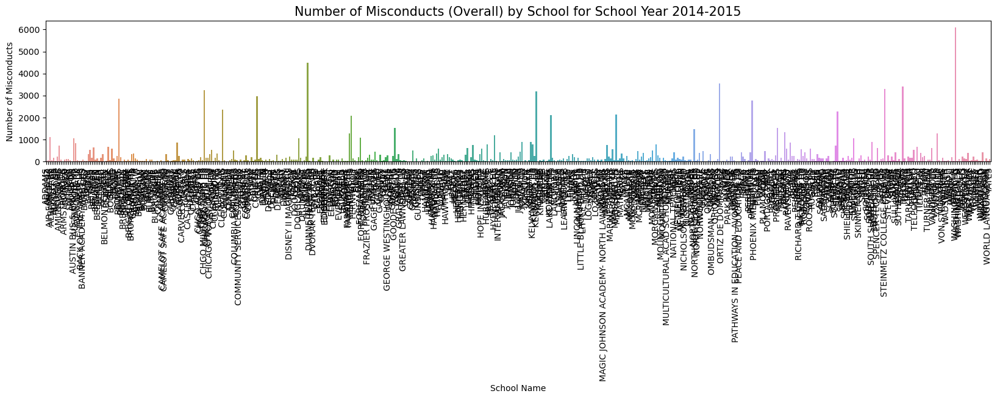

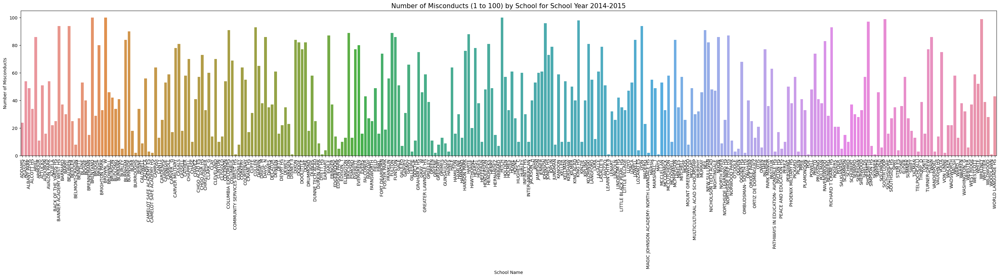

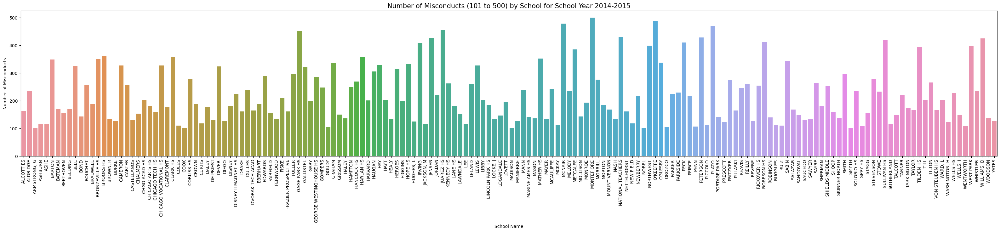

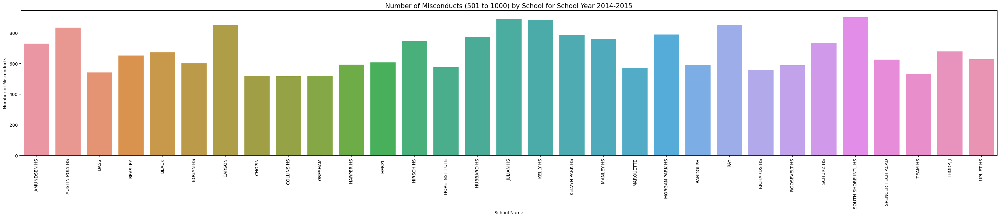

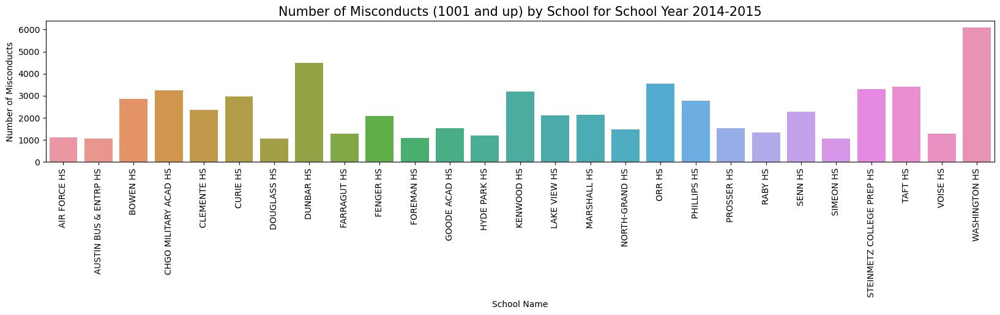

In [244]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1415['School Name'], y = SL1415['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1415v1to100['School Name'], y = SL1415v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1415v101to500['School Name'], y = SL1415v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1415v501to1000['School Name'], y = SL1415v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1415v1001to5000['School Name'], y = SL1415v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

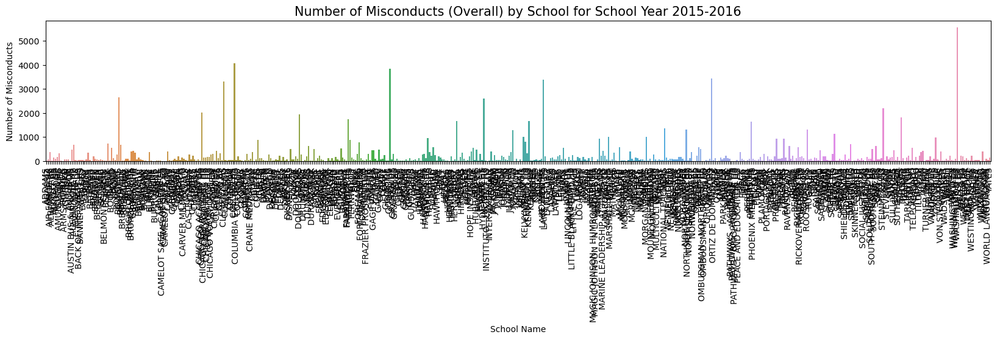

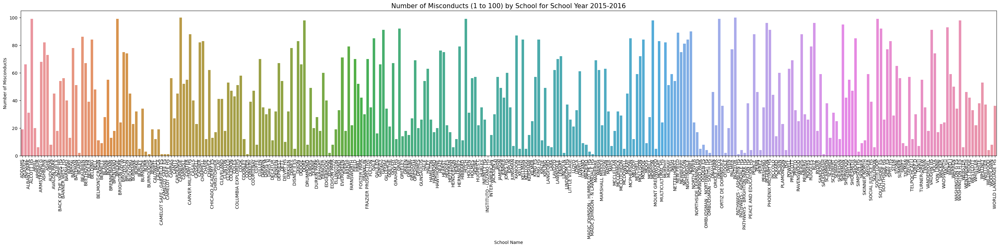

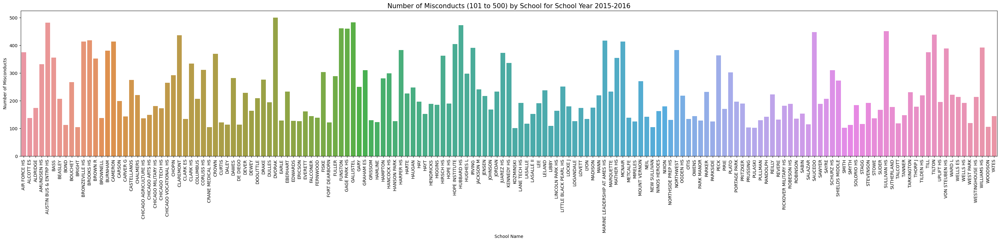

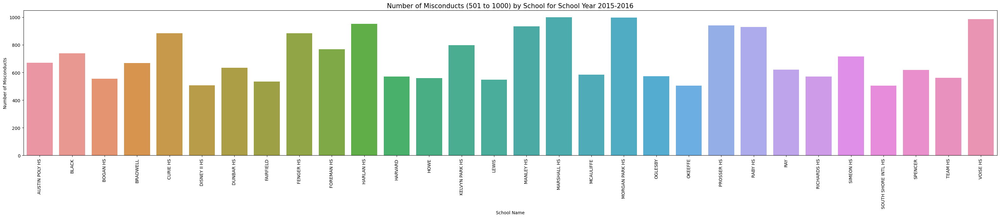

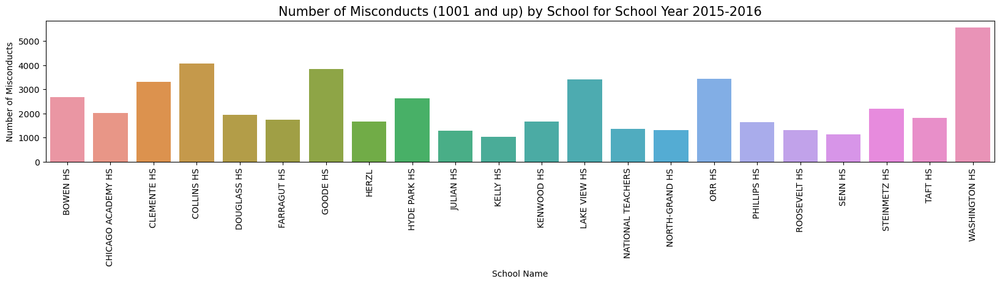

In [245]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1516['School Name'], y = SL1516['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1516v1to100['School Name'], y = SL1516v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1516v101to500['School Name'], y = SL1516v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1516v501to1000['School Name'], y = SL1516v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1516v1001to5000['School Name'], y = SL1516v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

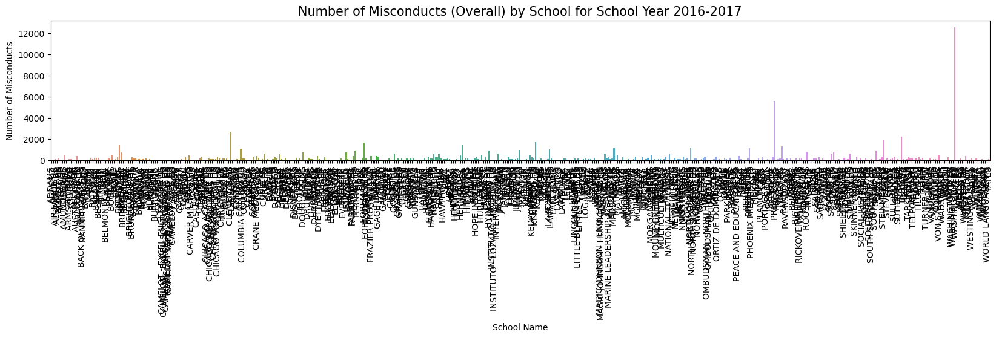

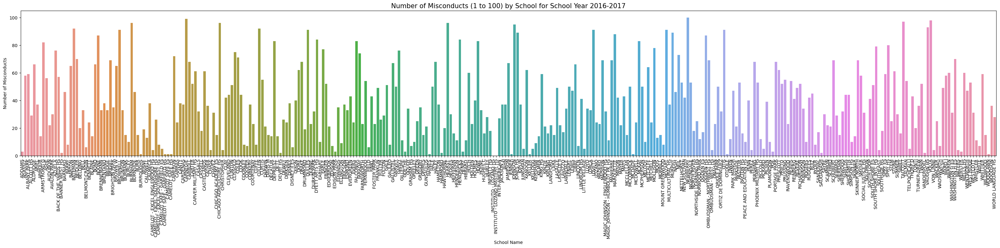

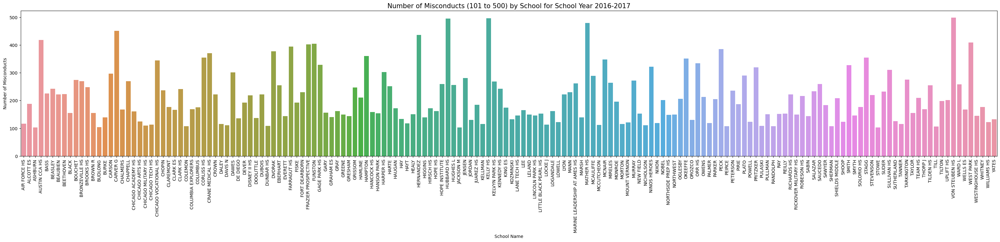

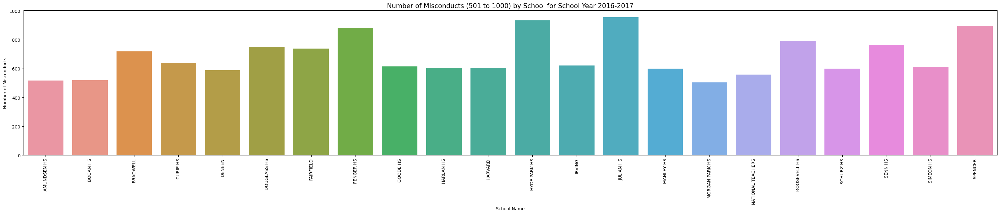

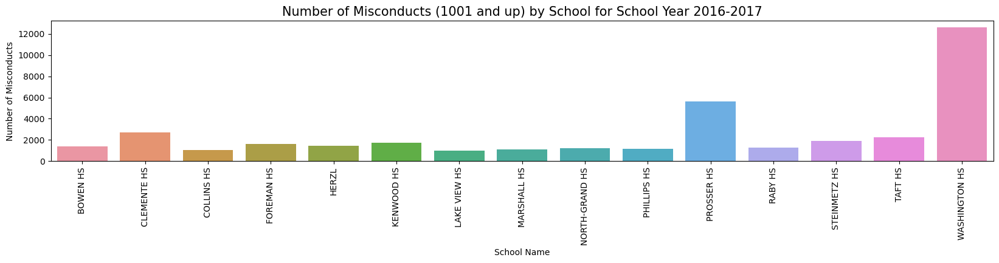

In [246]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1617['School Name'], y = SL1617['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1617v1to100['School Name'], y = SL1617v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1617v101to500['School Name'], y = SL1617v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1617v501to1000['School Name'], y = SL1617v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1617v1001to5000['School Name'], y = SL1617v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

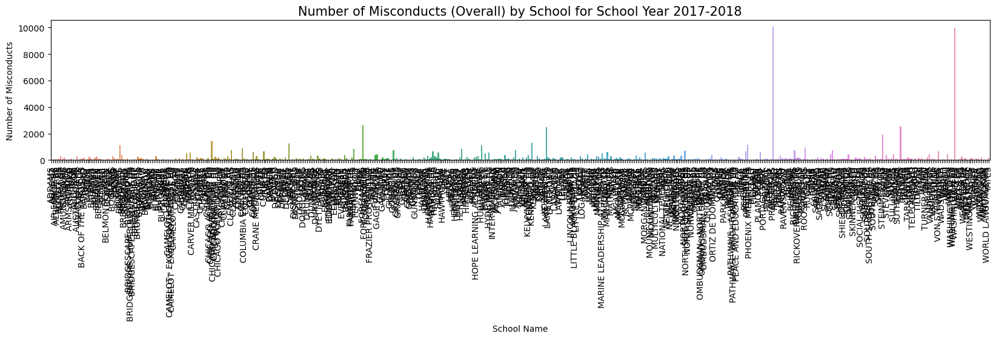

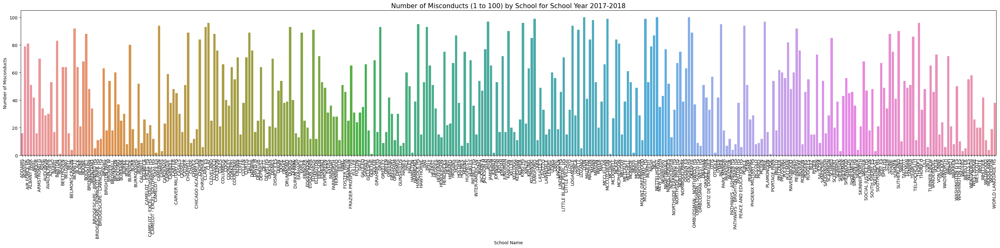

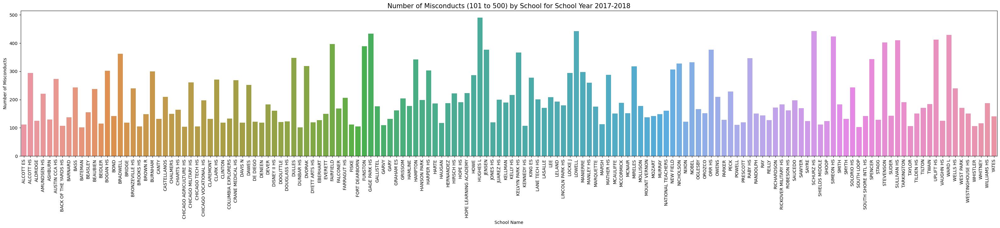

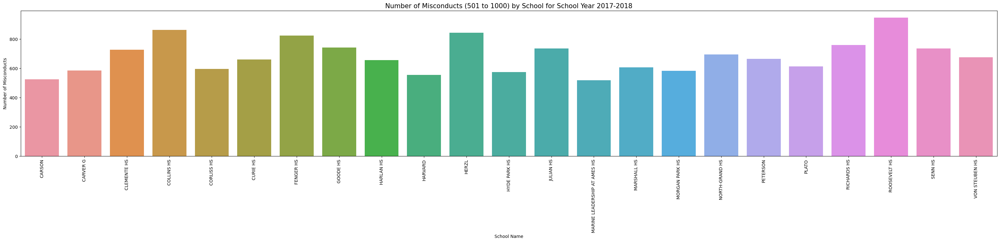

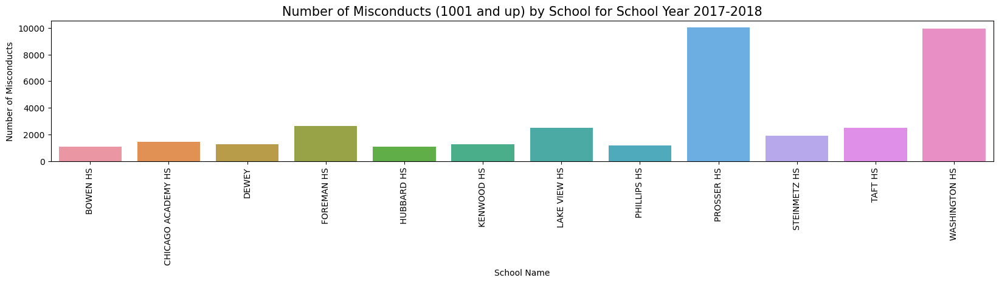

In [247]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1718['School Name'], y = SL1718['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1718v1to100['School Name'], y = SL1718v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1718v101to500['School Name'], y = SL1718v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1718v501to1000['School Name'], y = SL1718v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1718v1001to5000['School Name'], y = SL1718v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

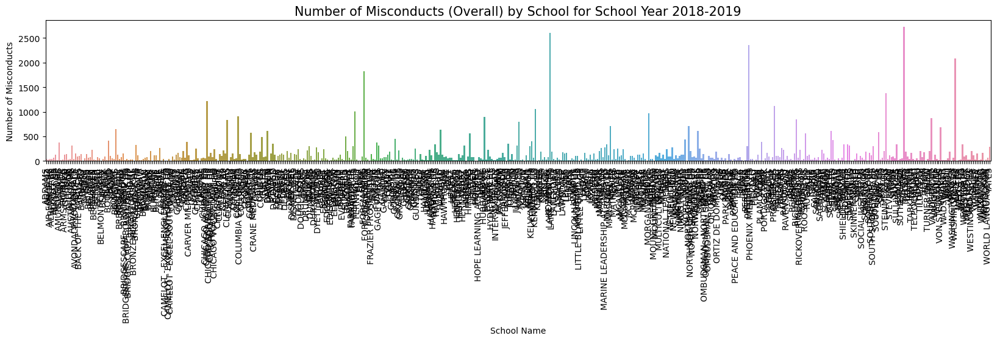

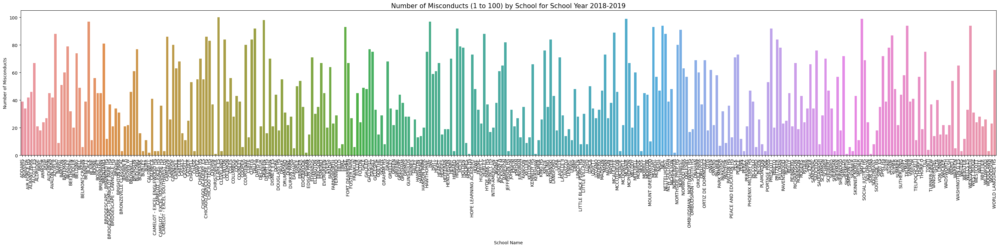

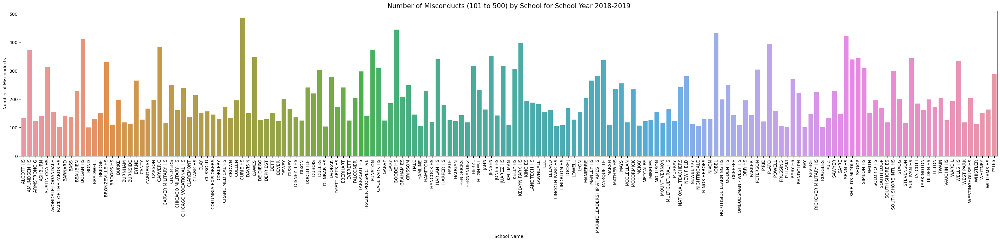

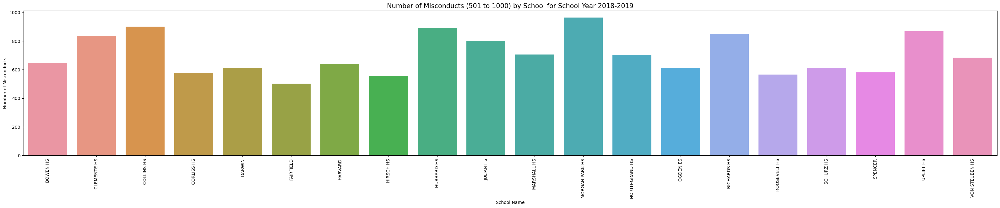

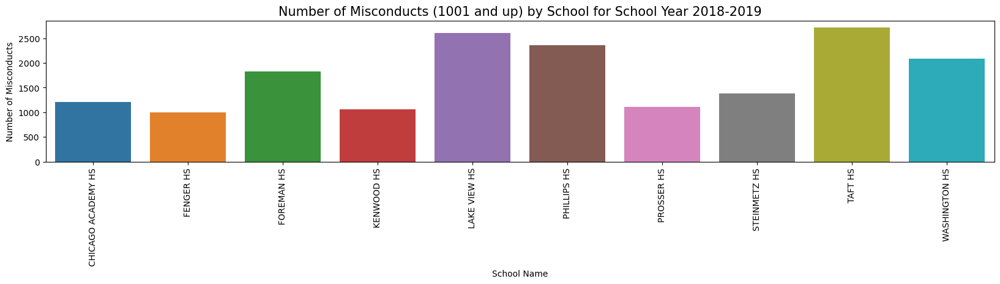

In [248]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1819['School Name'], y = SL1819['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1819v1to100['School Name'], y = SL1819v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1819v101to500['School Name'], y = SL1819v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1819v501to1000['School Name'], y = SL1819v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1819v1001to5000['School Name'], y = SL1819v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

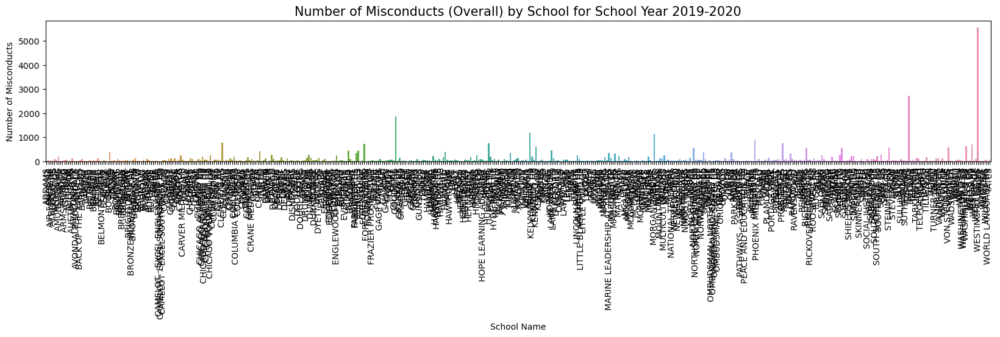

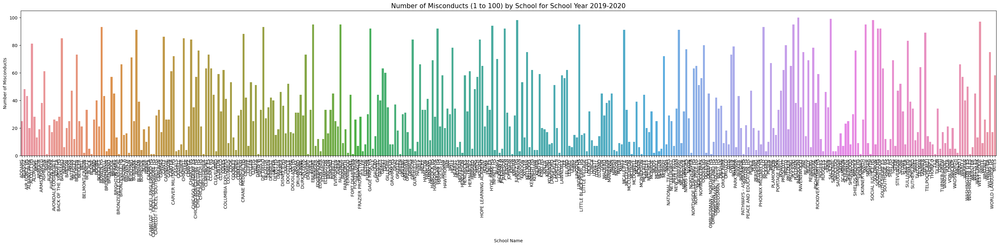

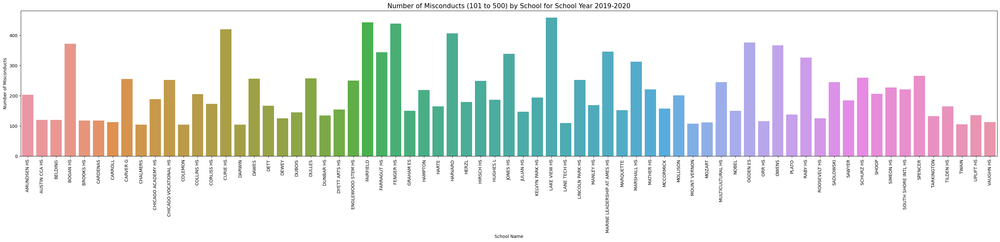

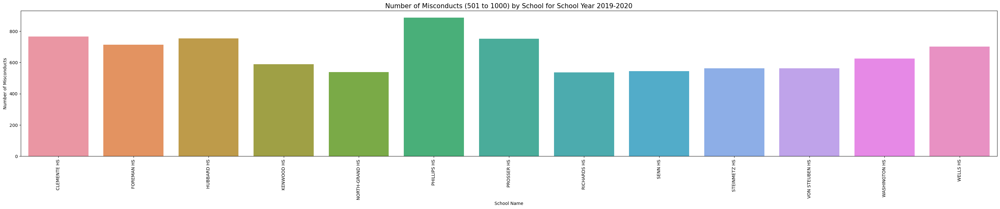

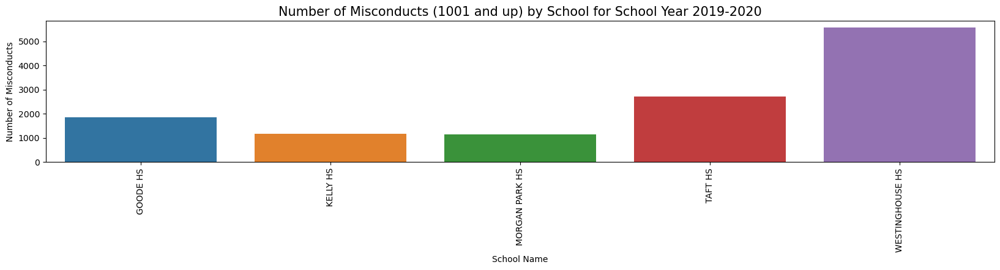

In [249]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1920['School Name'], y = SL1920['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1920v1to100['School Name'], y = SL1920v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1920v101to500['School Name'], y = SL1920v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL1920v501to1000['School Name'], y = SL1920v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL1920v1001to5000['School Name'], y = SL1920v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

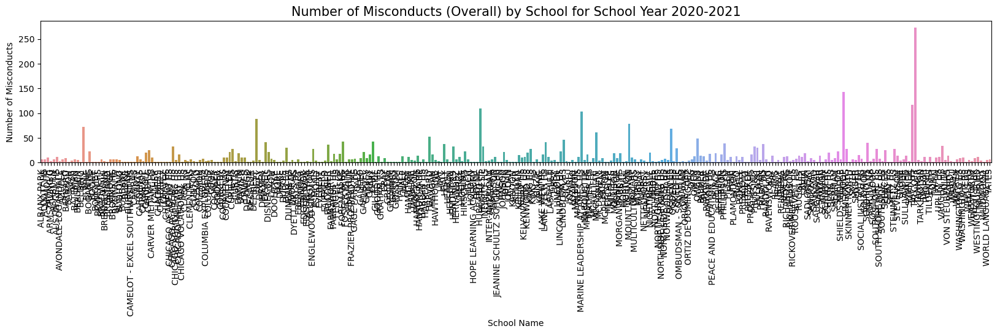

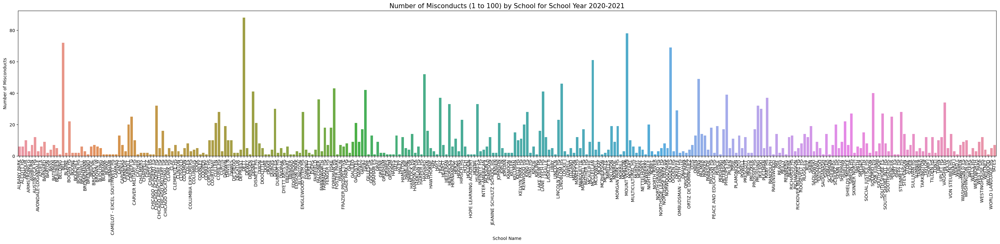

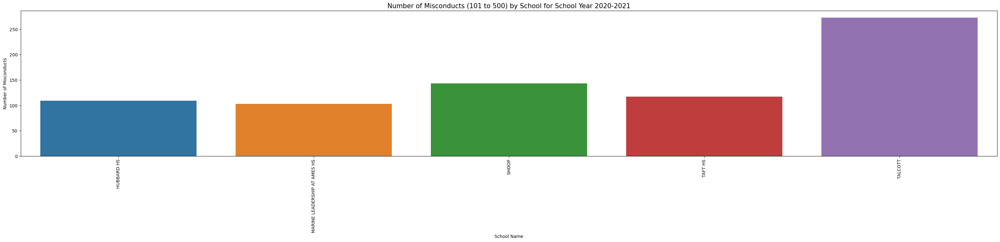

In [250]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL2021['School Name'], y = SL2021['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2020-2021', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL2021v1to100['School Name'], y = SL2021v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2020-2021', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL2021v101to500['School Name'], y = SL2021v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2020-2021', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

#Bins 501 to 1000 and 1001 and up were empty, most likely due to Covid restrictions

#

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(40,6))
# sns.barplot(x = SL2021v501to1000['School Name'], y = SL2021v501to1000['# of Misconducts'])

# plt.title('Number of Misconducts (501 to 1000) by School for School Year 2020-2021', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Misconducts');

#

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(20,3))
# sns.barplot(x = SL2021v1001to5000['School Name'], y = SL2021v1001to5000['# of Misconducts'])

# plt.title('Number of Misconducts (1001 and up) by School for School Year 2020-2021', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Misconducts');

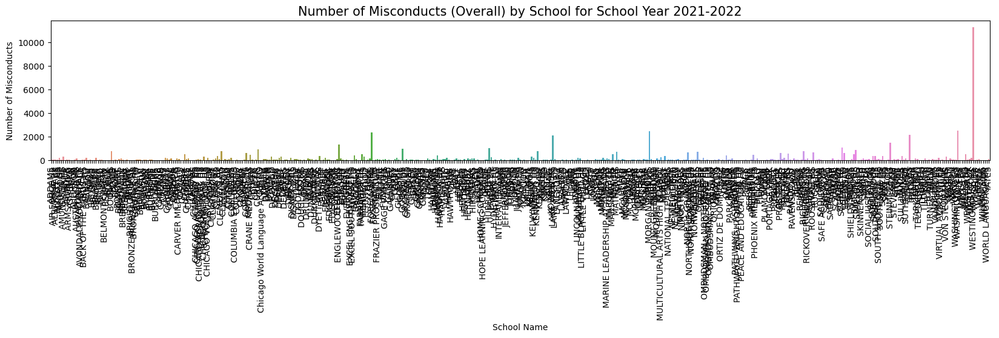

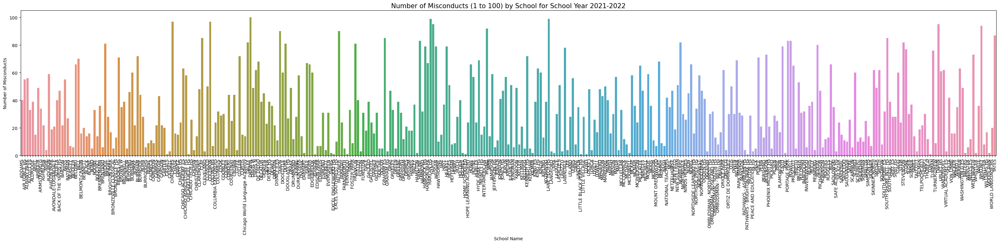

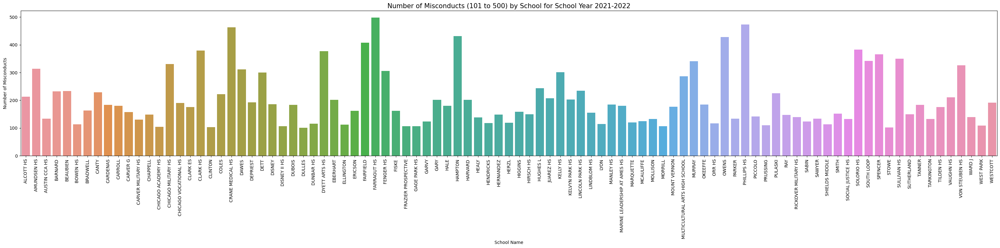

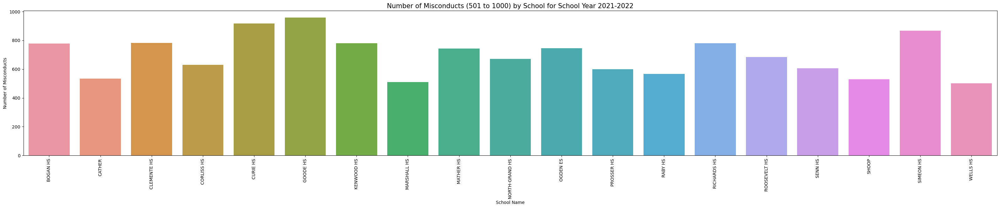

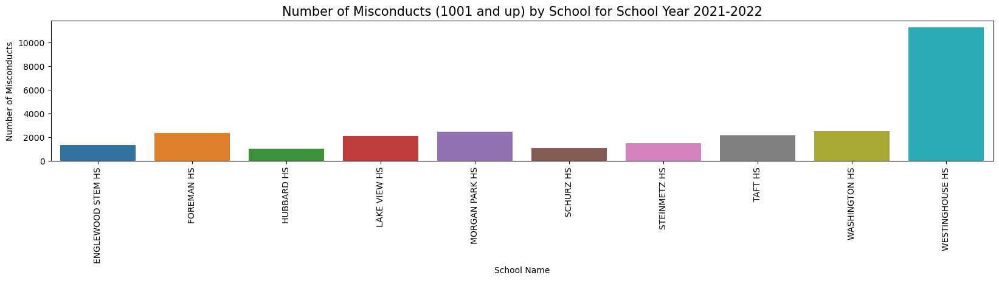

In [251]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL2122['School Name'], y = SL2122['# of Misconducts'])

plt.title('Number of Misconducts (Overall) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL2122v1to100['School Name'], y = SL2122v1to100['# of Misconducts'])

plt.title('Number of Misconducts (1 to 100) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL2122v101to500['School Name'], y = SL2122v101to500['# of Misconducts'])

plt.title('Number of Misconducts (101 to 500) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SL2122v501to1000['School Name'], y = SL2122v501to1000['# of Misconducts'])

plt.title('Number of Misconducts (501 to 1000) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SL2122v1001to5000['School Name'], y = SL2122v1001to5000['# of Misconducts'])

plt.title('Number of Misconducts (1001 and up) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Misconducts');

In [252]:
SLPN1314 = sl_2022.loc[(sl_2022['School Year'] == '2013-2014') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN1415 = sl_2022.loc[(sl_2022['School Year'] == '2014-2015') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN1516 = sl_2022.loc[(sl_2022['School Year'] == '2015-2016') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN1617 = sl_2022.loc[(sl_2022['School Year'] == '2016-2017') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN1718 = sl_2022.loc[(sl_2022['School Year'] == '2017-2018') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN1819 = sl_2022.loc[(sl_2022['School Year'] == '2018-2019') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN1920 = sl_2022.loc[(sl_2022['School Year'] == '2019-2020') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN2021 = sl_2022.loc[(sl_2022['School Year'] == '2020-2021') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]
SLPN2122 = sl_2022.loc[(sl_2022['School Year'] == '2021-2022') & (sl_2022['Time Period'] == 'EOY') & (sl_2022['# of Police Notifications'] != '--')]

In [253]:
print(np.dtype(SLPN1314['# of Police Notifications']))

object


In [254]:
SLPN1314 = SLPN1314.astype({'School Name': str, '# of Police Notifications': int})
SLPN1415 = SLPN1415.astype({'School Name': str, '# of Police Notifications': int})
SLPN1516 = SLPN1516.astype({'School Name': str, '# of Police Notifications': int})
SLPN1617 = SLPN1617.astype({'School Name': str, '# of Police Notifications': int})
SLPN1718 = SLPN1718.astype({'School Name': str, '# of Police Notifications': int})
SLPN1819 = SLPN1819.astype({'School Name': str, '# of Police Notifications': int})
SLPN1920 = SLPN1920.astype({'School Name': str, '# of Police Notifications': int})
SLPN2021 = SLPN2021.astype({'School Name': str, '# of Police Notifications': int})
SLPN2122 = SLPN2122.astype({'School Name': str, '# of Police Notifications': int})

In [255]:
SLPN1314v1to50 = SLPN1314.loc[(SLPN1314['# of Police Notifications'] <= 50)]
SLPN1314v51to100 = SLPN1314.loc[(SLPN1314['# of Police Notifications'] <= 100) & (SLPN1314['# of Police Notifications'] > 50)]
SLPN1314v101to5000 = SLPN1314.loc[(SLPN1314['# of Police Notifications'] > 100)]

SLPN1415v1to50 = SLPN1415.loc[(SLPN1415['# of Police Notifications'] <= 50)]
SLPN1415v51to100 = SLPN1415.loc[(SLPN1415['# of Police Notifications'] <= 100) & (SLPN1415['# of Police Notifications'] > 50)]
SLPN1415v101to5000 = SLPN1415.loc[(SLPN1415['# of Police Notifications'] > 100)]

SLPN1516v1to50 = SLPN1516.loc[(SLPN1516['# of Police Notifications'] <= 50)]
SLPN1516v51to100 = SLPN1516.loc[(SLPN1516['# of Police Notifications'] <= 100) & (SLPN1516['# of Police Notifications'] > 50)]
SLPN1516v101to5000 = SLPN1516.loc[(SLPN1516['# of Police Notifications'] > 100)]

SLPN1617v1to50 = SLPN1617.loc[(SLPN1617['# of Police Notifications'] <= 50)]
SLPN1617v51to100 = SLPN1617.loc[(SLPN1617['# of Police Notifications'] <= 100) & (SLPN1617['# of Police Notifications'] > 50)]
SLPN1617v101to5000 = SLPN1617.loc[(SLPN1617['# of Police Notifications'] > 100)]

SLPN1718v1to50 = SLPN1718.loc[(SLPN1718['# of Police Notifications'] <= 50)]
SLPN1718v51to100 = SLPN1718.loc[(SLPN1718['# of Police Notifications'] <= 100) & (SLPN1718['# of Police Notifications'] > 50)]
SLPN1718v101to5000 = SLPN1718.loc[(SLPN1718['# of Police Notifications'] > 100)]

SLPN1819v1to50 = SLPN1819.loc[(SLPN1819['# of Police Notifications'] <= 50)]
SLPN1819v51to100 = SLPN1819.loc[(SLPN1819['# of Police Notifications'] <= 100) & (SLPN1819['# of Police Notifications'] > 50)]
SLPN1819v101to5000 = SLPN1819.loc[(SLPN1819['# of Police Notifications'] > 100)]

SLPN1920v1to50 = SLPN1920.loc[(SLPN1920['# of Police Notifications'] <= 50)]
SLPN1920v51to100 = SLPN1920.loc[(SLPN1920['# of Police Notifications'] <= 100) & (SLPN1920['# of Police Notifications'] > 50)]
SLPN1920v101to5000 = SLPN1920.loc[(SLPN1920['# of Police Notifications'] > 100)]

SLPN2021v1to50 = SLPN2021.loc[(SLPN2021['# of Police Notifications'] <= 50)]
SLPN2021v51to100 = SLPN2021.loc[(SLPN2021['# of Police Notifications'] <= 100) & (SLPN2021['# of Police Notifications'] > 50)]
SLPN2021v101to5000 = SLPN2021.loc[(SLPN2021['# of Police Notifications'] > 100)]

SLPN2122v1to50 = SLPN2122.loc[(SLPN2122['# of Police Notifications'] <= 50)]
SLPN2122v51to100 = SLPN2122.loc[(SLPN2122['# of Police Notifications'] <= 100) & (SLPN2122['# of Police Notifications'] > 50)]
SLPN2122v101to5000 = SLPN2122.loc[(SLPN2122['# of Police Notifications'] > 100)]


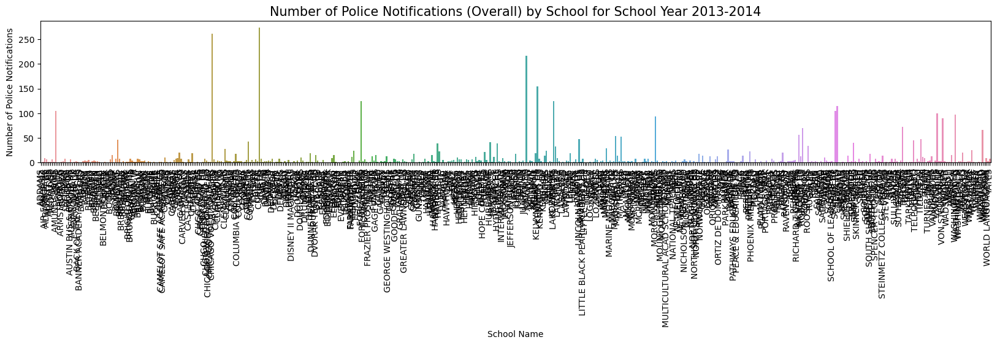

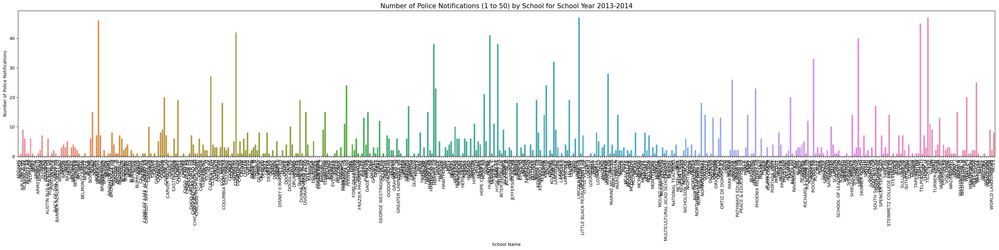

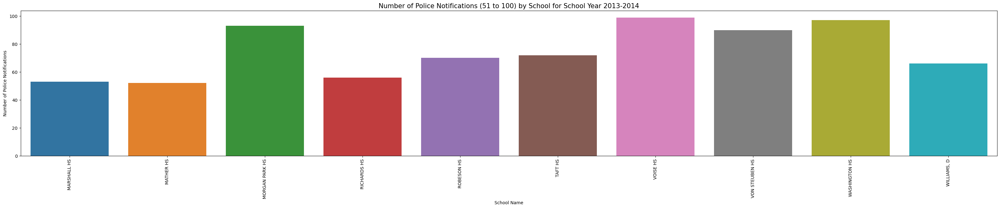

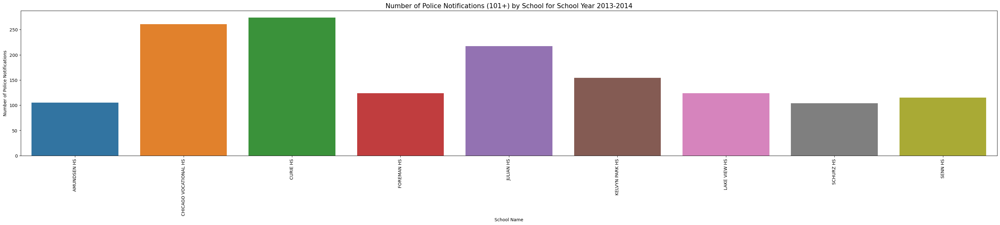

In [256]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1314['School Name'], y = SLPN1314['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1314v1to50['School Name'], y = SLPN1314v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1314v51to100['School Name'], y = SLPN1314v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1314v101to5000['School Name'], y = SLPN1314v101to5000['# of Police Notifications'])

plt.title('Number of Police Notifications (101+) by School for School Year 2013-2014', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

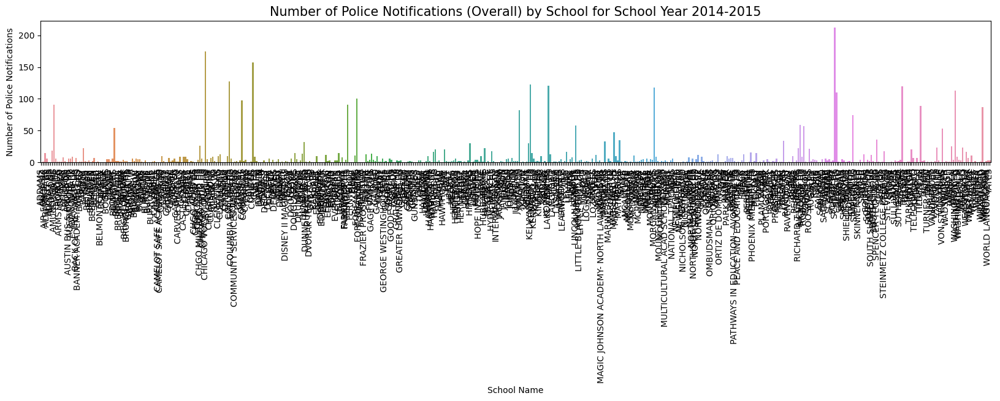

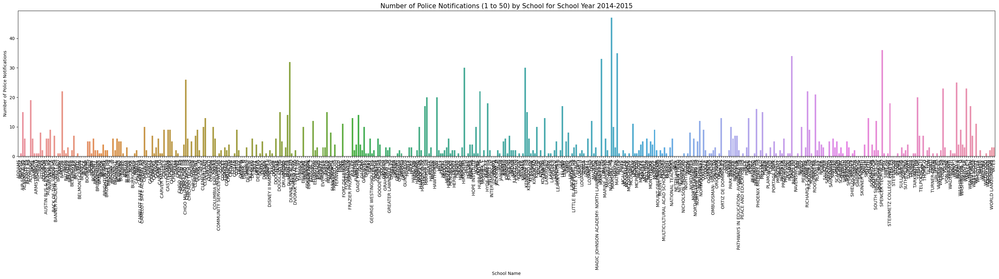

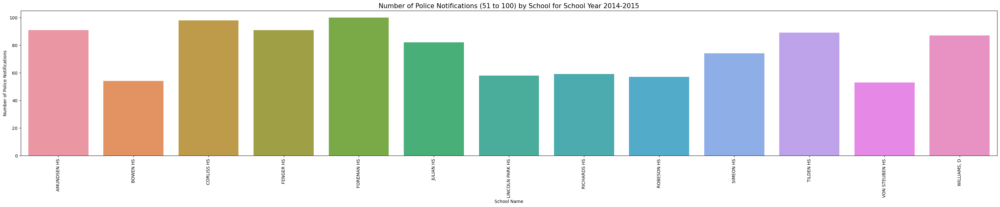

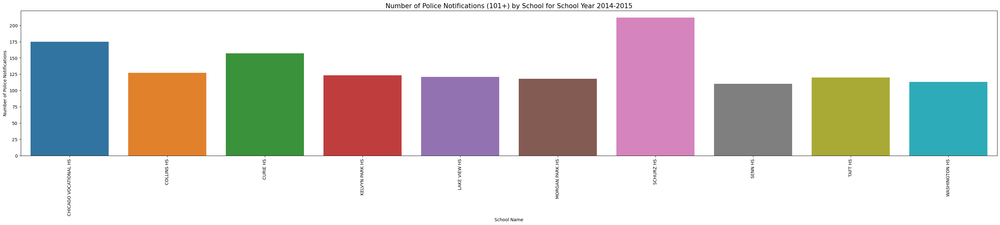

In [257]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1415['School Name'], y = SLPN1415['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1415v1to50['School Name'], y = SLPN1415v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1415v51to100['School Name'], y = SLPN1415v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1415v101to5000['School Name'], y = SLPN1415v101to5000['# of Police Notifications'])

plt.title('Number of Police Notifications (101+) by School for School Year 2014-2015', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

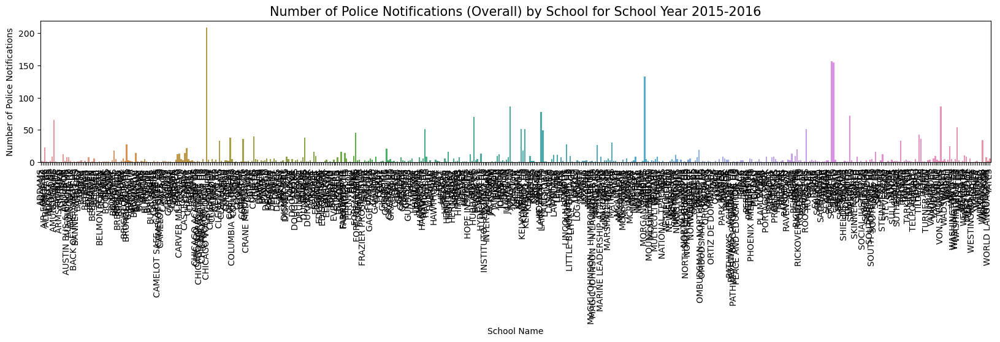

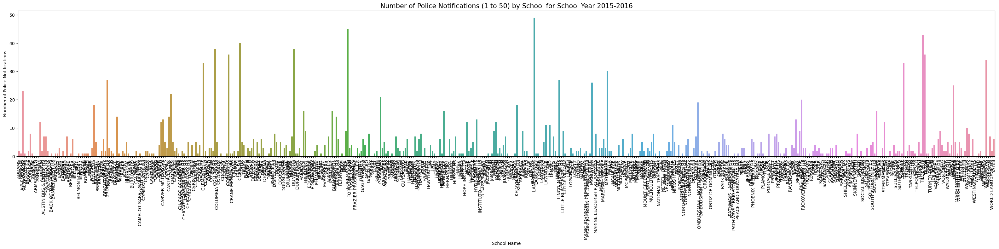

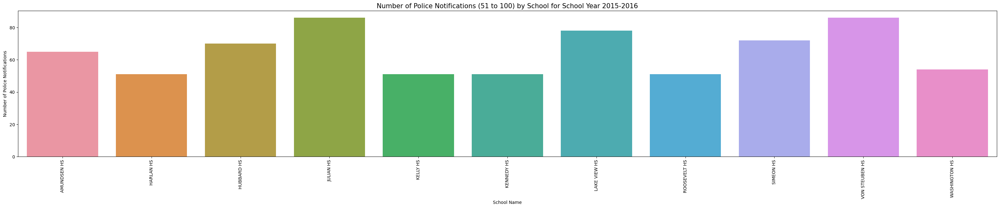

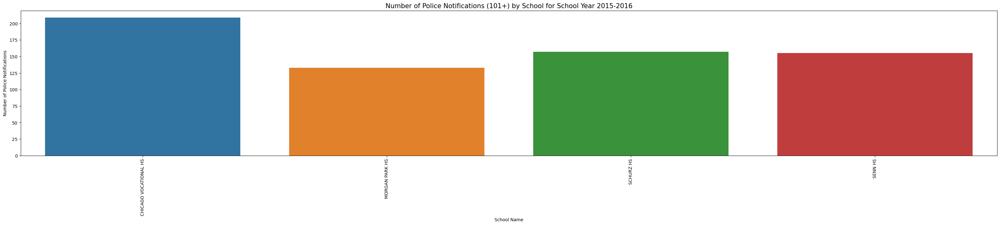

In [258]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1516['School Name'], y = SLPN1516['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1516v1to50['School Name'], y = SLPN1516v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1516v51to100['School Name'], y = SLPN1516v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1516v101to5000['School Name'], y = SLPN1516v101to5000['# of Police Notifications'])

plt.title('Number of Police Notifications (101+) by School for School Year 2015-2016', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

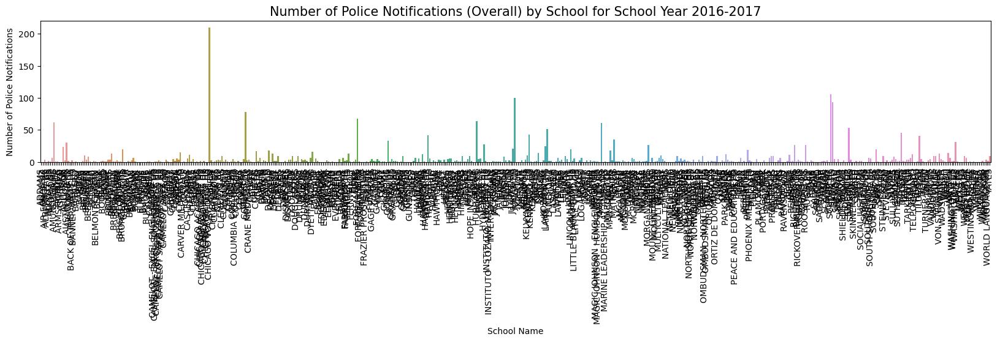

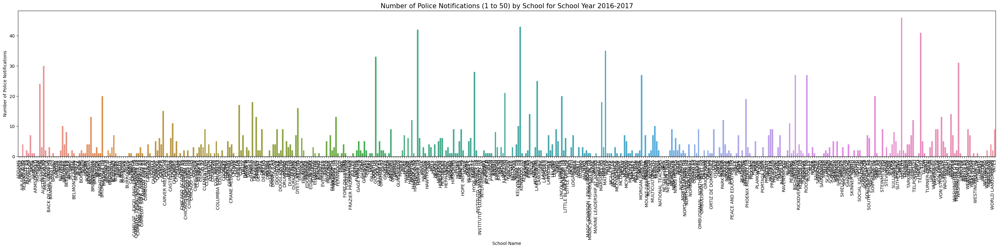

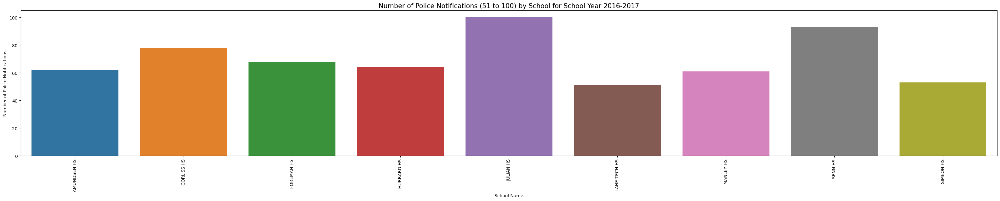

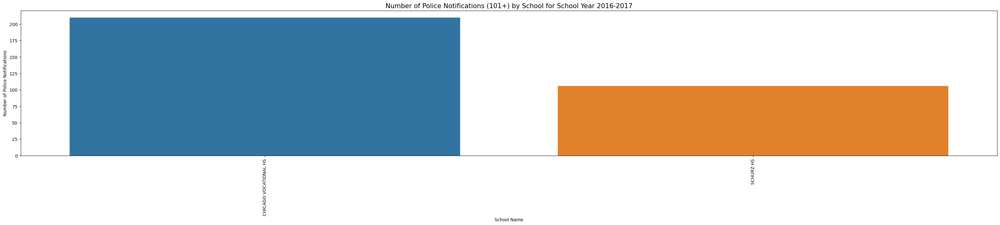

In [259]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1617['School Name'], y = SLPN1617['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1617v1to50['School Name'], y = SLPN1617v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1617v51to100['School Name'], y = SLPN1617v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1617v101to5000['School Name'], y = SLPN1617v101to5000['# of Police Notifications'])

plt.title('Number of Police Notifications (101+) by School for School Year 2016-2017', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

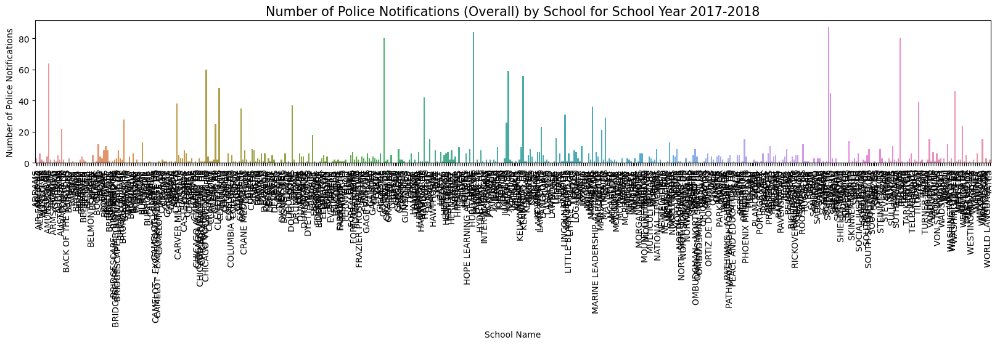

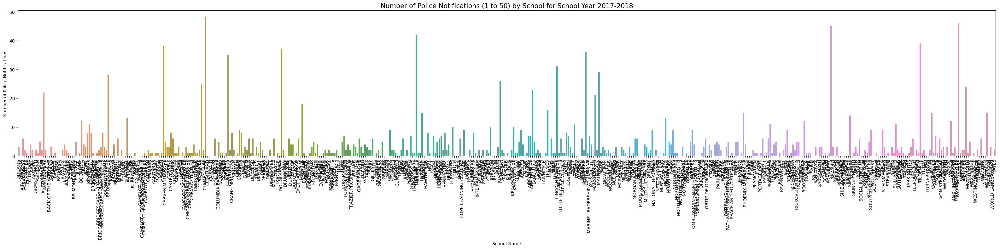

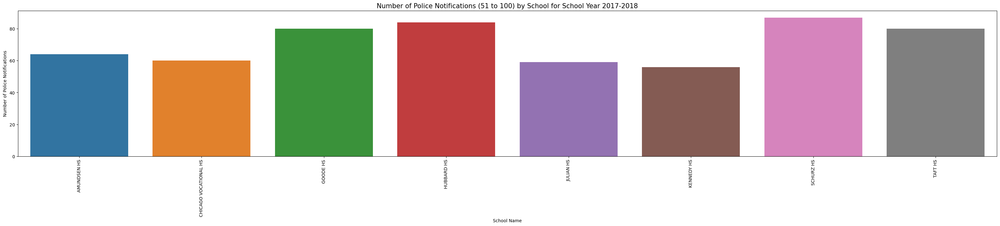

In [260]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1718['School Name'], y = SLPN1718['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1718v1to50['School Name'], y = SLPN1718v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1718v51to100['School Name'], y = SLPN1718v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2017-2018', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

# bin of 101+ has no values

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(40,6))
# sns.barplot(x = SLPN1718v101to5000['School Name'], y = SLPN1718v101to5000['# of Police Notifications'])

# plt.title('Number of Police Notifications (101+) by School for School Year 2017-2018', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Police Notifications');

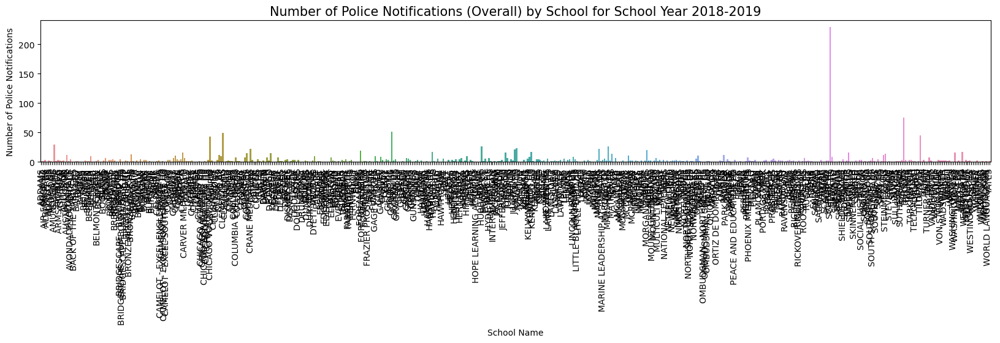

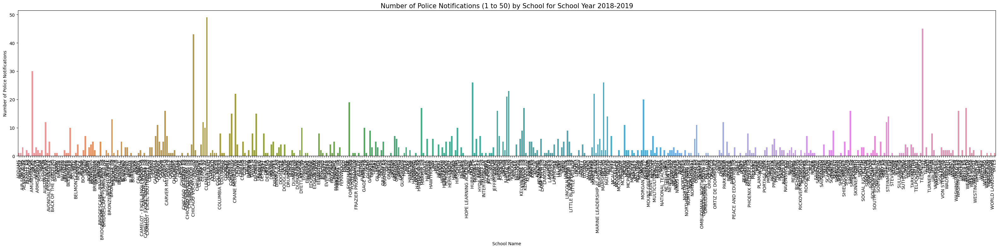

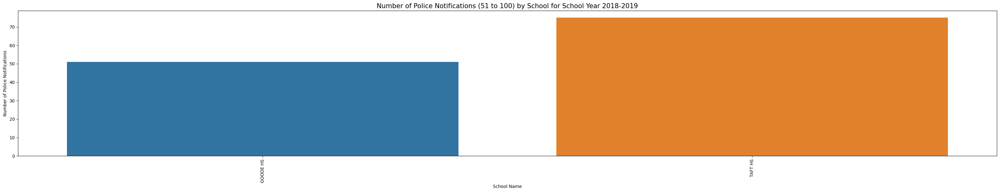

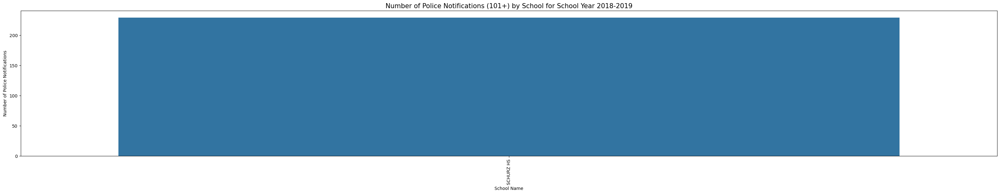

In [261]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1819['School Name'], y = SLPN1819['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1819v1to50['School Name'], y = SLPN1819v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1819v51to100['School Name'], y = SLPN1819v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1819v101to5000['School Name'], y = SLPN1819v101to5000['# of Police Notifications'])

plt.title('Number of Police Notifications (101+) by School for School Year 2018-2019', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

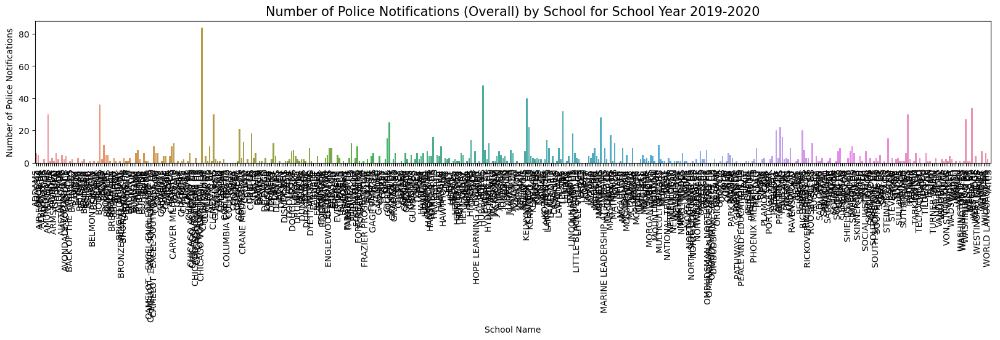

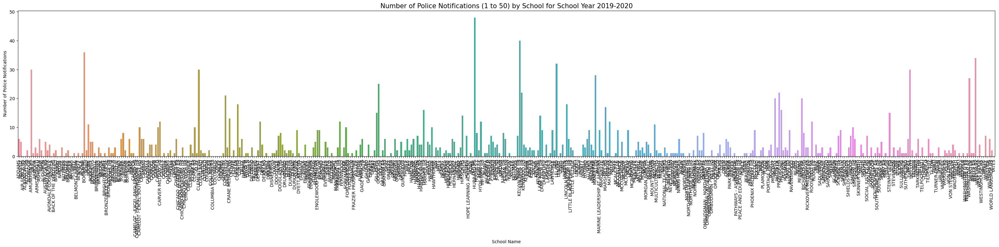

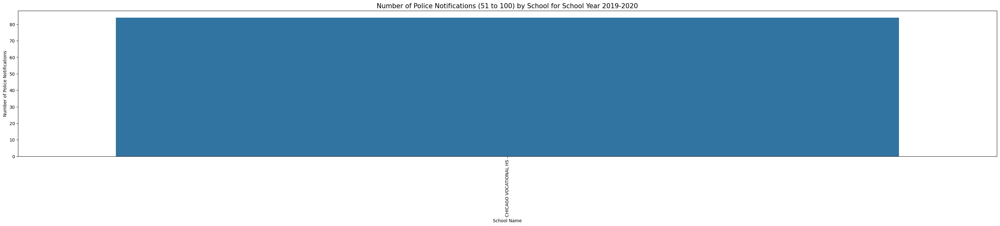

In [262]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN1920['School Name'], y = SLPN1920['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1920v1to50['School Name'], y = SLPN1920v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN1920v51to100['School Name'], y = SLPN1920v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2019-2020', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

# No values for bin 101+

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(40,6))
# sns.barplot(x = SLPN1920v101to5000['School Name'], y = SLPN1920v101to5000['# of Police Notifications'])

# plt.title('Number of Police Notifications (101+) by School for School Year 2019-2020', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Police Notifications');

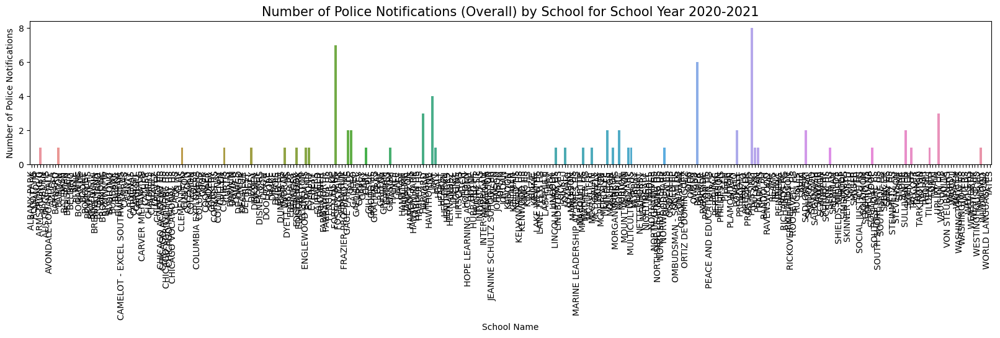

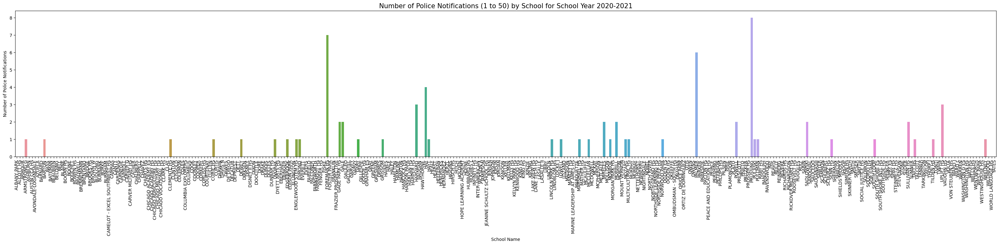

In [263]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN2021['School Name'], y = SLPN2021['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2020-2021', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN2021v1to50['School Name'], y = SLPN2021v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2020-2021', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

# No values for bin 51-100

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(40,6))
# sns.barplot(x = SLPN2021v51to100['School Name'], y = SLPN2021v51to100['# of Police Notifications'])

# plt.title('Number of Police Notifications (51 to 100) by School for School Year 2020-2021', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Police Notifications');

#

# No values for bin 101+

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(40,6))
# sns.barplot(x = SLPN2021v101to5000['School Name'], y = SLPN2021v101to5000['# of Police Notifications'])

# plt.title('Number of Police Notifications (101+) by School for School Year 2020-2021', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Police Notifications');

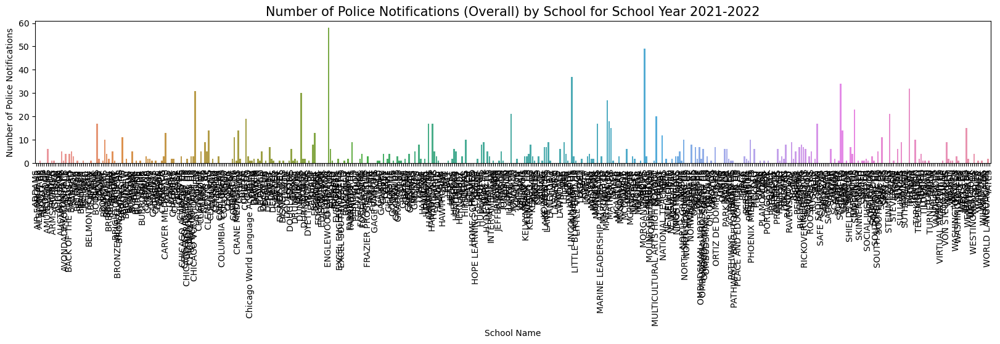

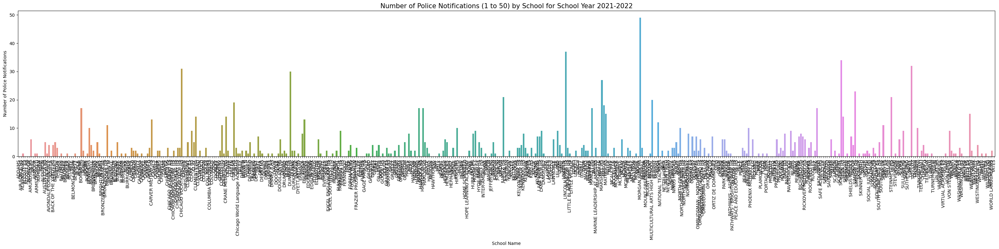

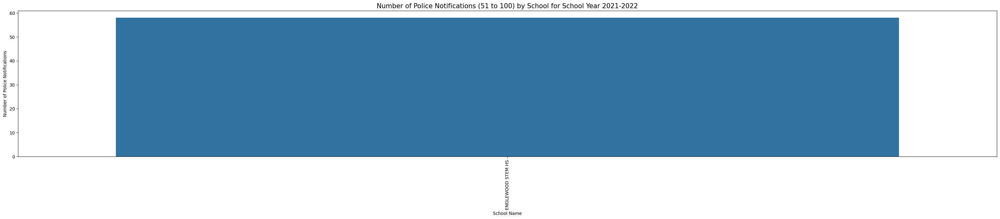

In [264]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(20,3))
sns.barplot(x = SLPN2122['School Name'], y = SLPN2122['# of Police Notifications'])

plt.title('Number of Police Notifications (Overall) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN2122v1to50['School Name'], y = SLPN2122v1to50['# of Police Notifications'])

plt.title('Number of Police Notifications (1 to 50) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(40,6))
sns.barplot(x = SLPN2122v51to100['School Name'], y = SLPN2122v51to100['# of Police Notifications'])

plt.title('Number of Police Notifications (51 to 100) by School for School Year 2021-2022', size = 15);
plt.xlabel('School Name');
plt.xticks(rotation = 90);
plt.ylabel('Number of Police Notifications');

#

# No values for bin 101+

# sns.set_palette(palette='tab10')
# plt.figure(figsize=(40,6))
# sns.barplot(x = SLPN2122v101to5000['School Name'], y = SLPN2122v101to5000['# of Police Notifications'])

# plt.title('Number of Police Notifications (101+) by School for School Year 22021-2022', size = 15);
# plt.xlabel('School Name');
# plt.xticks(rotation = 90);
# plt.ylabel('Number of Police Notifications');

..I may have a few too many plots

In [265]:
# Filtered date from 07/01/2013 00:0:00 AM to 06/30/2022 11:59:59 PM on https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-Present/ijzp-q8t2/data
# Downloaded filtered data as CSV

cc = pd.read_csv(r'C:\Users\AlbertProuty\Downloads\Crimes_-_2001_to_Present.csv', parse_dates=True)

In [266]:
cc.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,10263184,HY451000,07/01/2013 12:00:00 AM,065XX S KOMENSKY AVE,1751,OFFENSE INVOLVING CHILDREN,CRIM SEX ABUSE BY FAM MEMBER,RESIDENCE,False,True,...,13.0,65.0,20,1150497.0,1860853.0,2013,02/10/2018 03:50:01 PM,41.774076,-87.723862,"(41.774075726, -87.723862458)"
1,11466466,JB462168,07/01/2013 12:00:00 AM,076XX S KINGSTON AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,OTHER,False,False,...,7.0,43.0,11,NaN,NaN,2013,10/05/2018 03:59:12 PM,NaN,NaN,NaN
2,11478321,JB477486,07/01/2013 12:00:00 AM,050XX S HERMITAGE AVE,1754,OFFENSE INVOLVING CHILDREN,AGG SEX ASSLT OF CHILD FAM MBR,RESIDENCE,False,True,...,20.0,61.0,02,NaN,NaN,2013,10/25/2018 04:10:05 PM,NaN,NaN,NaN
3,10095151,HY284142,07/01/2013 12:00:00 AM,005XX E 90TH ST,1563,SEX OFFENSE,CRIMINAL SEXUAL ABUSE,APARTMENT,False,True,...,6.0,44.0,17,1181338.0,1845421.0,2013,02/10/2018 03:50:01 PM,41.731073,-87.611280,"(41.731073247, -87.611280355)"
4,11184186,JA558116,07/01/2013 12:00:00 AM,091XX S LAFLIN ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,OTHER,False,False,...,21.0,73.0,11,NaN,NaN,2013,12/22/2017 03:49:48 PM,NaN,NaN,NaN


In [267]:
print(cc.apply(lambda col: col.unique()))

ID                      [10263184, 11466466, 11478321, 10095151, 11184...
Case Number             [HY451000, JB462168, JB477486, HY284142, JA558...
Date                    [07/01/2013 12:00:00 AM, 07/01/2013 12:01:00 A...
Block                   [065XX S KOMENSKY AVE, 076XX S KINGSTON AVE, 0...
IUCR                    [1751, 1153, 1754, 1563, 0810, 0610, 0820, 175...
Primary Type            [OFFENSE INVOLVING CHILDREN, DECEPTIVE PRACTIC...
Description             [CRIM SEX ABUSE BY FAM MEMBER, FINANCIAL IDENT...
Location Description    [RESIDENCE, OTHER, APARTMENT, STREET, CONSTRUC...
Arrest                                                      [False, True]
Domestic                                                    [True, False]
Beat                    [833, 421, 931, 633, 2221, 1123, 1811, 221, 51...
District                [8.0, 4.0, 9.0, 6.0, 22.0, 11.0, 18.0, 2.0, 5....
Ward                    [13.0, 7.0, 20.0, 6.0, 21.0, 28.0, 32.0, 3.0, ...
Community Area          [65.0, 43.0, 6

In [268]:
cc2 = cc[['ID', 'Date', 'Arrest', 'Beat', 'District', 'Ward', 'Community Area']]
cc2.head()

,ID,Date,Arrest,Beat,District,Ward,Community Area
0,10263184,07/01/2013 12:00:00 AM,False,833,8.0,13.0,65.0
1,11466466,07/01/2013 12:00:00 AM,False,421,4.0,7.0,43.0
2,11478321,07/01/2013 12:00:00 AM,False,931,9.0,20.0,61.0
3,10095151,07/01/2013 12:00:00 AM,False,633,6.0,6.0,44.0
4,11184186,07/01/2013 12:00:00 AM,False,2221,22.0,21.0,73.0


In [269]:
cc3 = cc2

In [270]:
cc2['ID'].nunique()

2291313

In [271]:
cc2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2291313 entries, 0 to 2291312
Data columns (total 7 columns):
 #   Column          Dtype  
---  ------          -----  
 0   ID              int64  
 1   Date            object 
 2   Arrest          bool   
 3   Beat            int64  
 4   District        float64
 5   Ward            float64
 6   Community Area  float64
dtypes: bool(1), float64(3), int64(2), object(1)
memory usage: 107.1+ MB


In [272]:
cc2['Date'] = [x[:10] for x in cc2['Date']]

C:\Users\AlbertProuty\AppData\Local\Temp\ipykernel_19620\2993819072.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cc2['Date'] = [x[:10] for x in cc2['Date']]


In [273]:
cc2.tail()

,ID,Date,Arrest,Beat,District,Ward,Community Area
2291308,12747289,06/30/2022,True,1112,11.0,37.0,23.0
2291309,12747242,06/30/2022,True,132,1.0,3.0,33.0
2291310,12747291,06/30/2022,True,1911,19.0,47.0,5.0
2291311,12747272,06/30/2022,True,725,7.0,15.0,67.0
2291312,12747309,06/30/2022,True,1812,18.0,43.0,7.0


In [274]:
cc2['Date'] = cc2['Date'].astype('datetime64')
cc2['District'] = cc2['District'].fillna(0).astype('int')

C:\Users\AlbertProuty\AppData\Local\Temp\ipykernel_19620\1304050258.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cc2['Date'] = cc2['Date'].astype('datetime64')
C:\Users\AlbertProuty\AppData\Local\Temp\ipykernel_19620\1304050258.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cc2['District'] = cc2['District'].fillna(0).astype('int')


In [275]:
cc2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2291313 entries, 0 to 2291312
Data columns (total 7 columns):
 #   Column          Dtype         
---  ------          -----         
 0   ID              int64         
 1   Date            datetime64[ns]
 2   Arrest          bool          
 3   Beat            int64         
 4   District        int32         
 5   Ward            float64       
 6   Community Area  float64       
dtypes: bool(1), datetime64[ns](1), float64(2), int32(1), int64(2)
memory usage: 98.3 MB


In [276]:
# Only looking at data during the school years (07/01 to 06/30 with respective years)

CC1314 = cc2.loc[(cc2['Date'] >= '07/01/2013 12:00:00 AM') & (cc2['Date'] <= '06/30/2014 11:59:59 PM')]
CC1415 = cc2.loc[(cc2['Date'] >= '07/01/2014 12:00:00 AM') & (cc2['Date'] <= '06/30/2015 11:59:59 PM')]
CC1516 = cc2.loc[(cc2['Date'] >= '07/01/2015 12:00:00 AM') & (cc2['Date'] <= '06/30/2016 11:59:59 PM')]
CC1617 = cc2.loc[(cc2['Date'] >= '07/01/2016 12:00:00 AM') & (cc2['Date'] <= '06/30/2017 11:59:59 PM')]
CC1718 = cc2.loc[(cc2['Date'] >= '07/01/2017 12:00:00 AM') & (cc2['Date'] <= '06/30/2018 11:59:59 PM')]
CC1819 = cc2.loc[(cc2['Date'] >= '07/01/2018 12:00:00 AM') & (cc2['Date'] <= '06/30/2019 11:59:59 PM')]
CC1920 = cc2.loc[(cc2['Date'] >= '07/01/2019 12:00:00 AM') & (cc2['Date'] <= '06/30/2020 11:59:59 PM')]
CC2021 = cc2.loc[(cc2['Date'] >= '07/01/2020 12:00:00 AM') & (cc2['Date'] <= '06/30/2021 11:59:59 PM')]
CC2122 = cc2.loc[(cc2['Date'] >= '07/01/2021 12:00:00 AM') & (cc2['Date'] <= '06/30/2022 11:59:59 PM')]

In [277]:
CC1314.head()

,ID,Date,Arrest,Beat,District,Ward,Community Area
0,10263184,2013-07-01,False,833,8,13.0,65.0
1,11466466,2013-07-01,False,421,4,7.0,43.0
2,11478321,2013-07-01,False,931,9,20.0,61.0
3,10095151,2013-07-01,False,633,6,6.0,44.0
4,11184186,2013-07-01,False,2221,22,21.0,73.0


In [278]:
print(CC1314['ID'].nunique())
print(CC1415['ID'].nunique())
print(CC1516['ID'].nunique())
print(CC1617['ID'].nunique())
print(CC1718['ID'].nunique())
print(CC1819['ID'].nunique())
print(CC1920['ID'].nunique())
print(CC2021['ID'].nunique())
print(CC2122['ID'].nunique())


288146
269839
267414
270403
267323
266346
237229
206402
218211


In [279]:
cc2['District'].unique()

array([ 8,  4,  9,  6, 22, 11, 18,  2,  5, 25, 19, 14,  1,  3, 10, 16, 17,
       15,  7, 24, 12, 20, 31,  0])

In [280]:
cc2['District'].nunique()

24

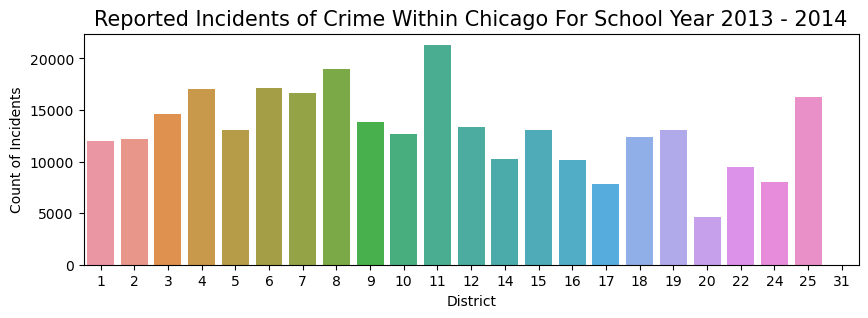

In [281]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1314['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2013 - 2014', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

Missing data from districts 13, 21, 23, and no clue what that district 31 is.

Update:  On the Chicago Police website, there are no districts 13, 21, or 23.
    Looks as though police district 13 was closed at the end of 2012 and was combined with district 12.
    District 21 was also absorbed by nearby districts.
    District 23 was absorbed by district 19.
Specific data on which districts absorbed which seems to be lacking.

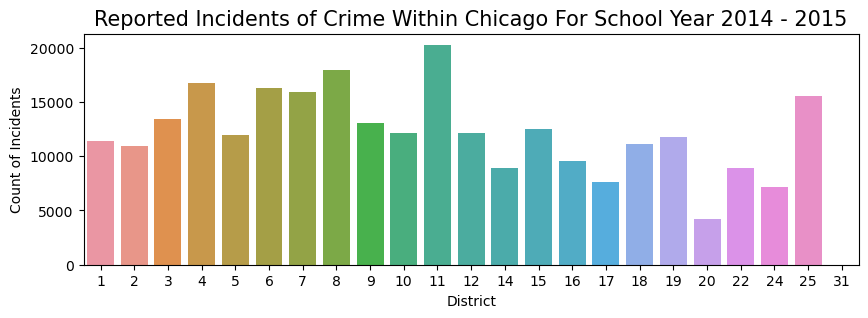

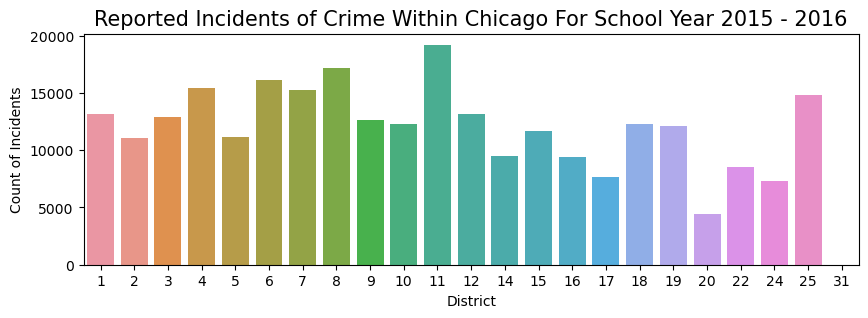

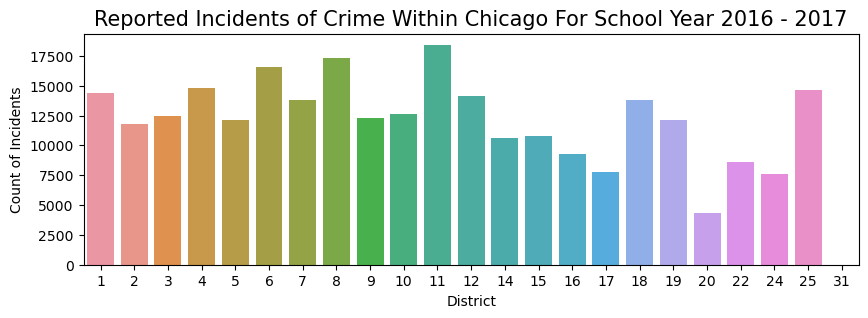

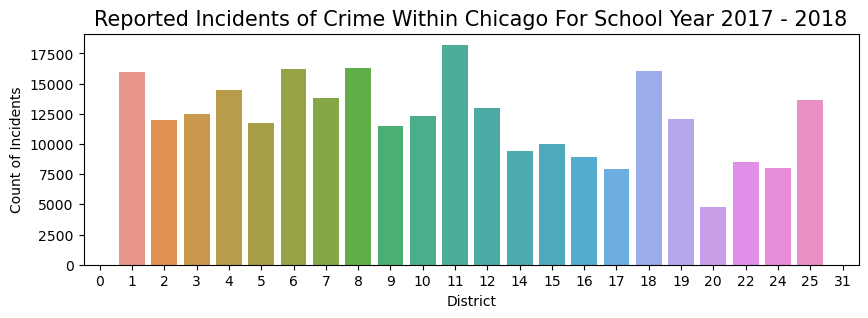

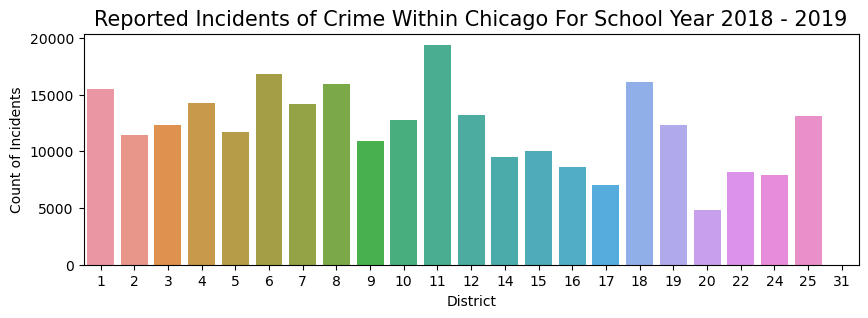

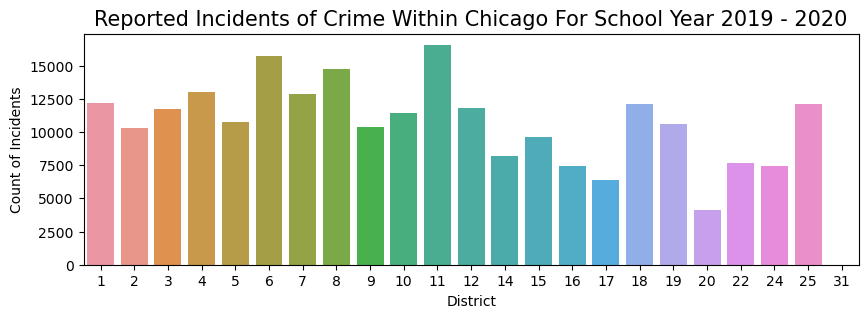

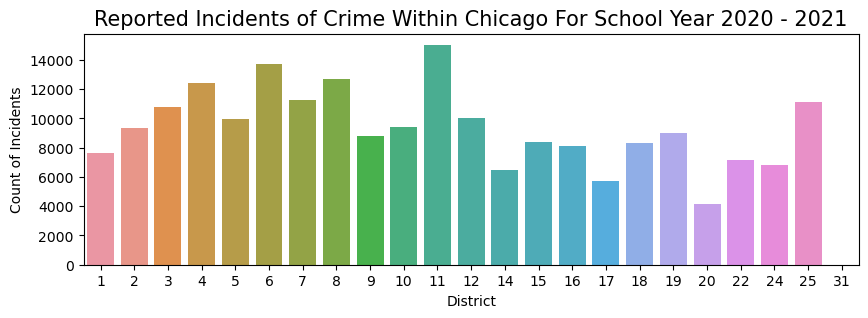

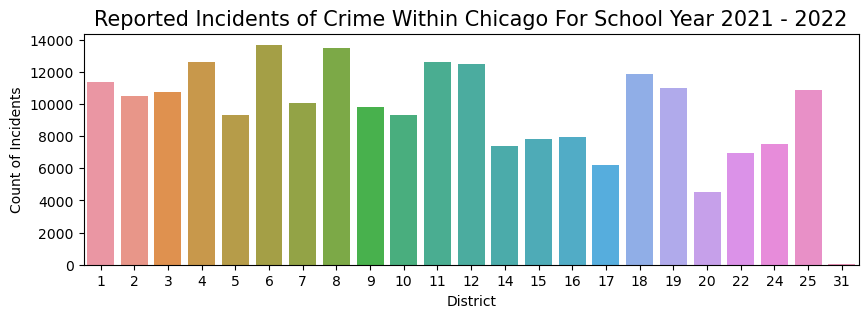

In [282]:
sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1415['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2014 - 2015', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1516['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2015 - 2016', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1617['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2016 - 2017', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1718['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2017 - 2018', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1819['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2018 - 2019', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC1920['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2019 - 2020', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC2021['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2020 - 2021', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

#

sns.set_palette(palette='tab10')
plt.figure(figsize=(10,3))
sns.countplot(x = CC2122['District'])

plt.title('Reported Incidents of Crime Within Chicago For School Year 2021 - 2022', size = 15);
plt.xlabel('District');
plt.ylabel('Count of Incidents');

Going to dive deeper into the schools with the top 5 # of Misconducts per school year and keep # of Police Notifications and % of misconducts resulting in Police Notifications. Once that's done, I'll be comparing that to the reported incidents of crime per related school year.

In [288]:
SLF1314 = SL1314.sort_values('# of Misconducts', ascending=False).head()
SLF1415 = SL1415.sort_values('# of Misconducts', ascending=False).head()
SLF1516 = SL1516.sort_values('# of Misconducts', ascending=False).head()
SLF1617 = SL1617.sort_values('# of Misconducts', ascending=False).head()
SLF1718 = SL1718.sort_values('# of Misconducts', ascending=False).head()
SLF1819 = SL1819.sort_values('# of Misconducts', ascending=False).head()
SLF1920 = SL1920.sort_values('# of Misconducts', ascending=False).head()
SLF2021 = SL2021.sort_values('# of Misconducts', ascending=False).head() # No data for larger bins; probably Covid related lol
SLF2122 = SL2122.sort_values('# of Misconducts', ascending=False).head()

In [291]:
SLF1314 = SLF1314[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF1415 = SLF1415[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF1516 = SLF1516[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF1617 = SLF1617[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF1718 = SLF1718[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF1819 = SLF1819[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF1920 = SLF1920[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF2021 = SLF2021[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]
SLF2122 = SLF2122[['School Name', 'School Year', '# of Misconducts', '# of Police Notifications', '% of Misconducts Resulting in a Police Notification']]

In [296]:
SLF1314.head(10)

,School Name,School Year,# of Misconducts,# of Police Notifications,% of Misconducts Resulting in a Police Notification
8914,WASHINGTON HS,2014-2015,6088,113,1.9
2533,DUNBAR HS,2014-2015,4476,32,0.7
6566,ORR HS,2014-2015,3552,13,0.4
8351,TAFT HS,2014-2015,3412,120,3.5
8181,STEINMETZ COLLEGE PREP HS,2014-2015,3292,18,0.5


In [312]:
SLF1322 = pd.concat([SLF1314, SLF1415, SLF1516, SLF1617, SLF1718, SLF1819, SLF1920, SLF2021, SLF2122])
CCF1316 = pd.concat([CC1314, CC1415, CC1516])
CCF1619 = pd.concat([CC1617, CC1718, CC1819])
CCF1922 = pd.concat([CC1920, CC2021, CC2122])

In [308]:
print(SLF1322.shape)
print(CCF1322.shape)

(45, 5)
(2291313, 7)


In [310]:
#CCF1322.head() had to break things down into three subdfs as the main one was too big for excel

,ID,Date,Arrest,Beat,District,Ward,Community Area
0,10263184,2013-07-01,False,833,8,13.0,65.0
1,11466466,2013-07-01,False,421,4,7.0,43.0
2,11478321,2013-07-01,False,931,9,20.0,61.0
3,10095151,2013-07-01,False,633,6,6.0,44.0
4,11184186,2013-07-01,False,2221,22,21.0,73.0


Was this efficient? Not at all! Was my laziness worth not having to scroll up? Possibly not!

Created this list of top 5 # of Misconducts per school year and reported incidents stuff to play around with in Excel to see whether or not I remember how to use Excel/Power BI.

In [313]:
SLF1322.to_excel(r'SLF1314.xlsx', index=False)
#CCF1322.to_excel(r'CCF1322.xlsx', index=False) This sheet size is 2291313, 7; Max sheet size is 1048576, 16384

CCF1316.to_excel(r'CCF1316.xlsx', index=False)
CCF1619.to_excel(r'CCF1619.xlsx', index=False)
CCF1922.to_excel(r'CCF1922.xlsx', index=False)